# <center> Времянные ряды
## <center>неделя 4
<center>Глазунов А.В.

Подключаем диск

In [2]:
from google.colab import drive
drive.mount('/content/gdrive',force_remount=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


Переходим в директорию, загружаем библиотеки

In [3]:
cd /content/gdrive/'My Drive'/Colab_Notebooks/ML_c6_TAXI

/content/gdrive/My Drive/Colab_Notebooks/ML_c6_TAXI


In [0]:
PATH_TO_DATA = 'data'

In [0]:
import warnings
warnings.filterwarnings('ignore')


from sklearn.base import BaseEstimator, TransformerMixin

import os
import pandas as pd
import numpy as np
from scipy import stats
from tqdm import tqdm_notebook
from matplotlib import pyplot as plt
import seaborn as sns
sns.set_style("darkgrid")
import gc
import statsmodels.api as sm
from sklearn.linear_model import LinearRegression
from itertools import product
from sklearn.metrics import mean_absolute_error as mae
from sklearn.cluster import KMeans, AgglomerativeClustering

import scipy.cluster.hierarchy as shc

from scipy.cluster.hierarchy import dendrogram

from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer

from sklearn.manifold import TSNE,MDS
import folium


from sklearn.preprocessing import PowerTransformer

from scipy import stats
from dateutil.relativedelta import relativedelta

Список рассматриваемых зон

In [6]:
zones = ['1075', '1076', '1077', '1125', '1126', '1127', '1128', '1129', '1130', '1131', '1132', '1172', '1173', '1174', '1175', \
         '1176', '1177', '1178', '1179', '1180', '1181', '1182', '1183', '1184', '1221', '1222', '1223', '1224', '1225', '1227',\
        '1228', '1229', '1230', '1231', '1232', '1233', '1234', '1235', '1272', '1273', '1274', '1278', '1279', '1280', '1281',\
        '1282', '1283', '1284', '1285', '1286', '1287', '1326', '1327', '1331', '1332', '1333', '1334', '1335', '1336', '1337', \
        '1338', '1339', '1376', '1377', '1378', '1380', '1382', '1383', '1384', '1385', '1386', '1387', '1388', '1389', '1390', \
        '1426', '1431', '1434', '1435', '1436', '1437', '1438', '1439', '1441', '1442', '1480', '1482', '1483', '1530', '1532', \
        '1533', '1580', '1630', '1684', '1733', '1734', '1783', '2068', '2069', '2118', '2119', '2168']
zones = list(map(np.int64,zones))
len(zones)

102

Загружаем 6 месяцев (декабрь 2015 г. - март 2016 г.)

In [7]:
%%time
time_series_6_month = pd.read_csv(os.path.join(PATH_TO_DATA,'time_series_6_month.csv'),index_col=0)
time_series_6_month.columns = range(1,2501)
dt = [pd.to_datetime(tt) for tt in list(time_series_6_month.index)]
time_series_6_month.index = dt
time_series_6_month.head()

CPU times: user 1.56 s, sys: 184 ms, total: 1.74 s
Wall time: 2.1 s


Выделяем апрель, на нем будет проводится кластеризация

In [0]:
data_april = time_series_6_month.loc[pd.to_datetime('2016-04-01 00:00:00'):pd.to_datetime('2016-04-30 23:00:00')].copy()

In [9]:
data_april_zones = data_april[zones].copy()
data_april_zones.head()

,1075,1076,1077,1125,1126,1127,1128,1129,1130,1131,1132,1172,1173,1174,1175,1176,1177,1178,1179,1180,1181,1182,1183,1184,1221,1222,1223,1224,1225,1227,1228,1229,1230,1231,1232,1233,1234,1235,1272,1273,...,1376,1377,1378,1380,1382,1383,1384,1385,1386,1387,1388,1389,1390,1426,1431,1434,1435,1436,1437,1438,1439,1441,1442,1480,1482,1483,1530,1532,1533,1580,1630,1684,1733,1734,1783,2068,2069,2118,2119,2168
2016-04-01 00:00:00,46,55,31,67,171,300,521,603,716,161,10,9,18,23,9,36,611,804,512,634,448,379,105,4,6,6,19,38,2,387,608,549,862,709,1045,447,153,62,12,27,...,39,16,8,9,14,70,217,48,24,30,20,15,14,15,12,1,4,31,26,10,4,6,11,6,14,7,9,11,18,2,4,0,2,158,50,104,14,175,53,96
2016-04-01 01:00:00,25,44,16,46,90,228,325,436,598,121,3,6,20,20,6,24,500,468,302,300,213,278,140,1,6,9,13,19,4,308,414,359,518,463,616,221,91,25,10,14,...,44,22,10,11,6,41,126,39,20,18,16,12,17,8,17,1,8,23,20,9,4,4,3,8,10,5,8,7,11,4,8,0,4,3,16,67,14,165,13,68
2016-04-01 02:00:00,12,23,13,20,58,146,177,299,557,55,1,3,10,9,2,30,300,291,187,190,161,217,162,0,2,9,14,18,0,254,294,239,290,296,347,120,39,14,6,6,...,36,18,10,8,4,13,66,29,6,17,15,13,10,9,8,0,3,15,18,6,7,0,3,7,9,7,8,16,13,2,9,0,0,0,1,18,2,26,0,7
2016-04-01 03:00:00,8,9,4,20,32,141,70,164,498,52,1,0,3,3,0,20,241,162,115,131,88,153,86,2,1,6,7,6,1,187,209,143,169,202,283,107,24,17,5,6,...,32,13,7,0,3,27,54,11,13,15,10,12,4,8,6,1,3,9,16,3,6,2,6,5,5,6,6,12,12,2,4,0,2,0,0,0,0,6,0,1
2016-04-01 04:00:00,9,13,4,16,33,115,55,129,239,21,0,0,7,2,0,13,137,102,85,102,120,136,32,0,1,2,7,7,1,91,148,133,143,159,268,90,27,14,1,0,...,20,3,4,3,3,24,80,26,10,10,11,7,9,4,10,0,5,20,11,10,10,4,3,13,28,11,15,14,10,6,8,1,3,3,2,1,0,10,0,1


Визуальный анализ рядов

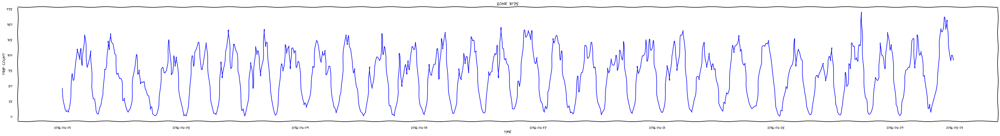

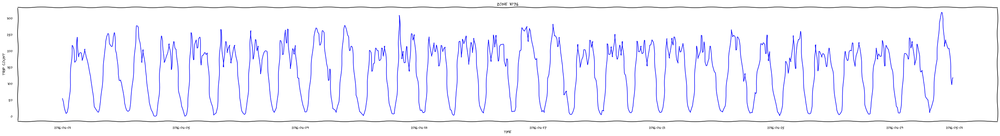

In [10]:
def time_series_plot(ts,zone_id):
  with plt.xkcd():
    plt.figure(figsize=(50,6))
    plt.plot(ts, color = 'blue',linewidth = 1.5)
    plt.grid(True)
    plt.xlabel('time')
    plt.ylabel('trip count')
    plt.title(f'Zone {zone_id}')

for col in data_april_zones.columns[:2]:
  time_series_plot(data_april_zones[col],col)

Нормализация

In [0]:
def normalisation(df):
  normed_df = df.copy()
  norm_coef = {}
  for col in df.columns:
    
    norm_coef[col]=[normed_df[col].mean(),normed_df[col].std()]
    normed_df[col] = (normed_df[col]-norm_coef[col][0])/norm_coef[col][1]
    
  return normed_df,norm_coef

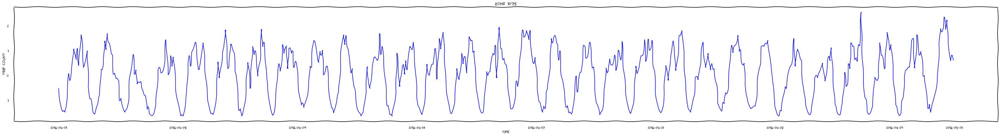

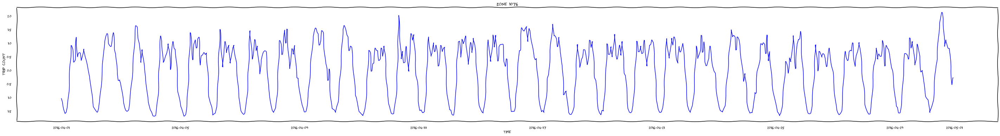

In [12]:
data_zones_april_normed,norm_coef = normalisation(data_april_zones)
for col in data_zones_april_normed.columns[:2]:
  time_series_plot(data_zones_april_normed[col],col)

Создадим признаки для рядов на основе статистик и данных по автокорреляции

In [0]:
def create_fe(data):
  df = data.copy()
  
  features={}
  for col in data.columns:
    #автокорреляционные признаки
    fe_list0 = list(sm.graphics.tsa.acf(df[col].values.squeeze(),nlags=168))    
    fe_list = fe_list0[1:]

    #медиана
    fe_list.append(df[col].median())
    
    #признаки, основанные на количестве пиков и впадин
    row_shifted =   df[col] - df[col].min()
    
    fe_list.append(sum(row_shifted>0.9*row_shifted.max())*720/row_shifted.shape[0])
    fe_list.append(sum(row_shifted<0.1*row_shifted.max())*720/row_shifted.shape[0])
    fe_list.append((df[col].max()-df[col].min())/df[col].max())   
    
    
    #индикатор основной активности (выходные или рабочие дни)
    st_we = [st for st in list(df[col].index) if st.weekday() == 5 or st.weekday() == 6]
    we_count = sum(df[col].loc[st_we])

    st_wd = [st for st in list(df[col].index) if st.weekday() != 5 and st.weekday() != 6]
    wd_count = sum(df[col].loc[st_wd])

    w_w_indic = int(2.5*we_count / wd_count > 1)

    fe_list.append(w_w_indic)   
    


    features[col] = fe_list


  feats_df = pd.DataFrame(features).T

  return  feats_df

Попробуем воспользоваться kmeans и примерно подобрать число кластеров с учетом качества и скорости решения.

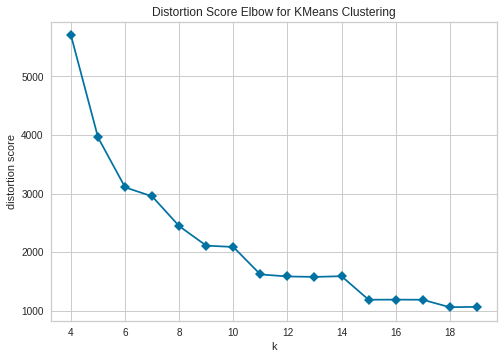

In [14]:
features = create_fe(data_zones_april_normed)
model01 = KMeans(random_state=42)
visualizer = KElbowVisualizer(model01, k=(4,20), timings=False)
visualizer.fit(features)    
visualizer.poof()

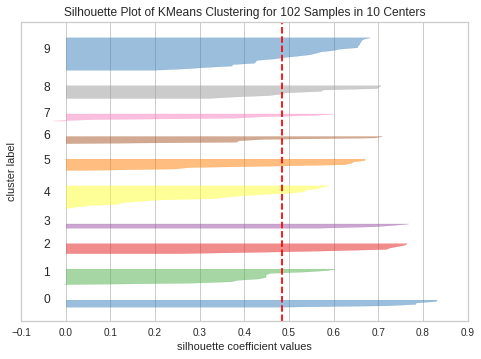

In [15]:
model02 = KMeans(10,random_state=42)
visualizer = SilhouetteVisualizer(model02)

visualizer.fit(features)    
visualizer.poof()    

Предварительно, 10 кластеров оптимально (см. график для правила локтя и коэффициента силуэта). Посмотрим на результаты кластеризации на признаках.

In [0]:
model1 = KMeans(n_clusters=10,random_state=42).fit(features)

суммарное отклонение от центров кластеров 1829.65
среднее отклонение от центров кластеров 17.94


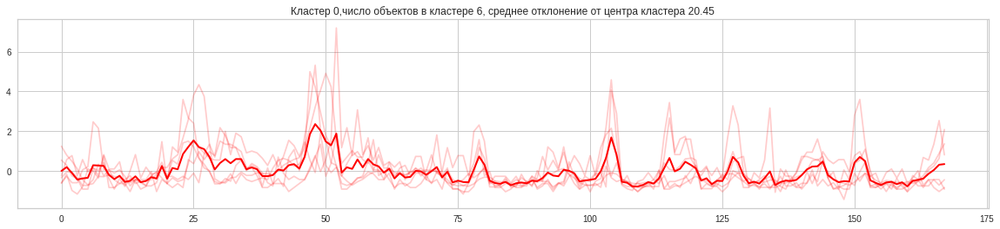

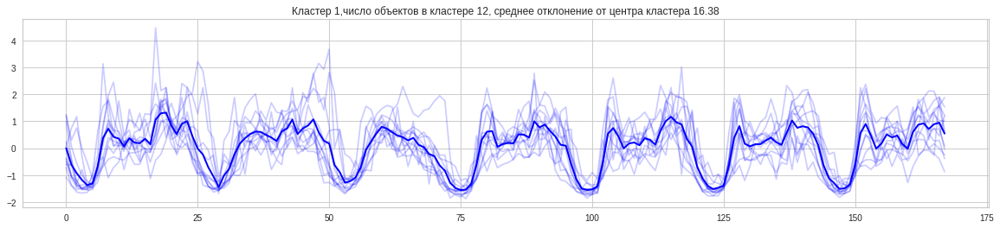

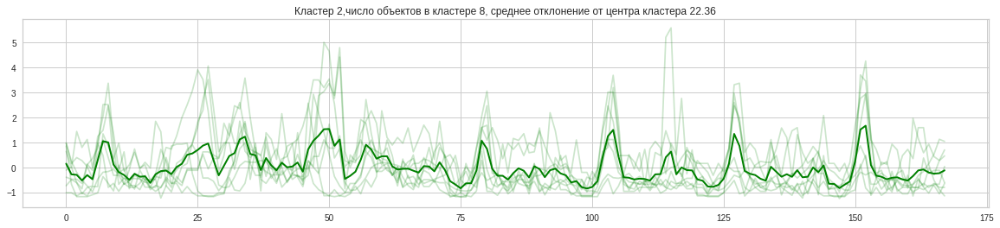

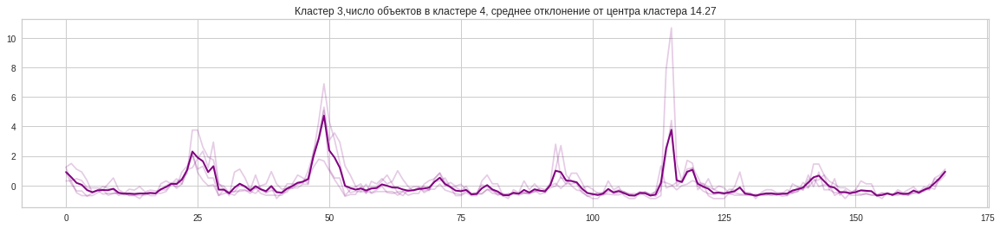

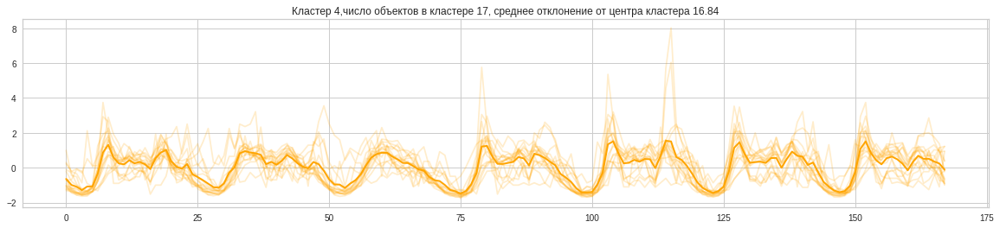

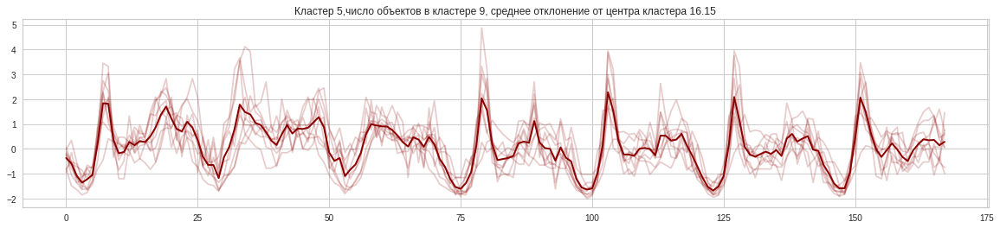

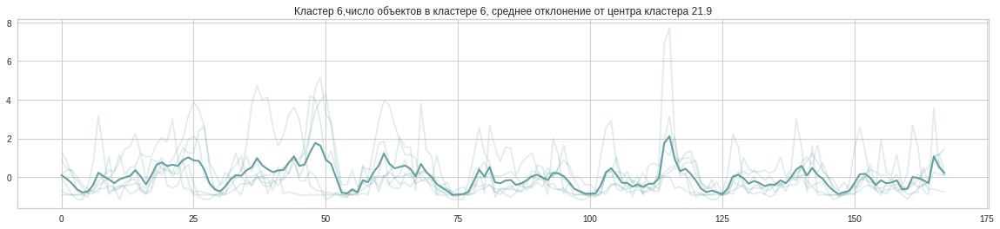

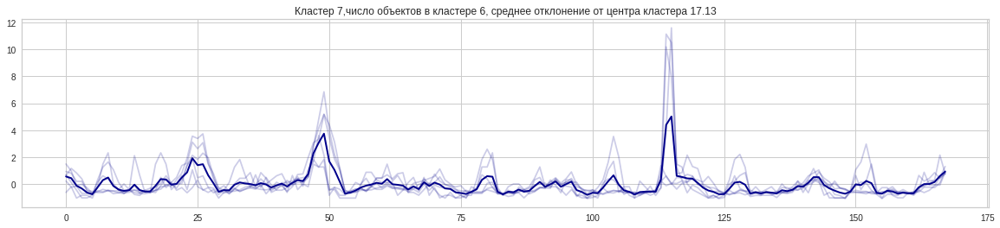

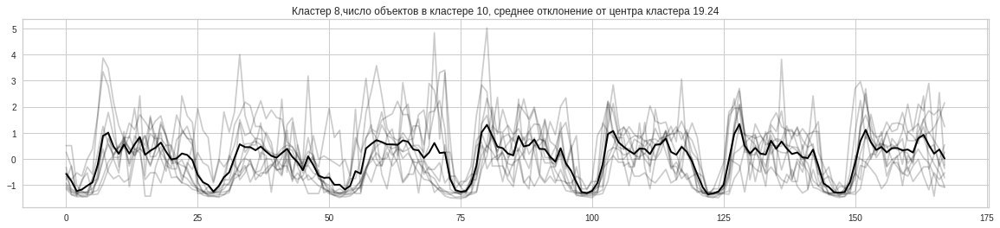

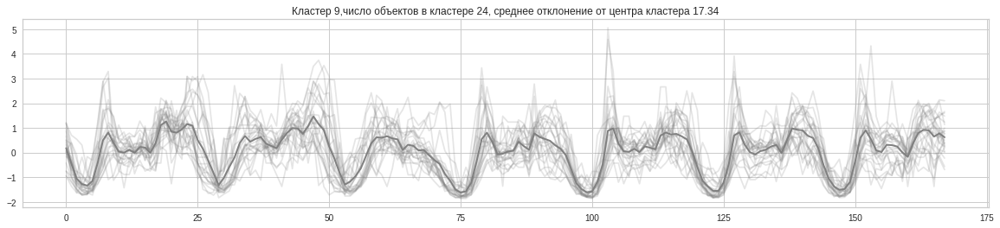

In [17]:
def cluster_center(data):
  data_to_work = data.copy().T   
  result = [data_to_work[column].mean() for column in  data_to_work.columns]
  return pd.Series(result,index=data_to_work.columns)


def plot_clusters(model_fitted,data):


  def cluster_center(data):
    data_to_work = data.copy().T   
    result = [data_to_work[column].mean() for column in  data_to_work.columns]
    return pd.Series(result,index=data_to_work.columns)

  color_dict = {0:'red',1:'blue',2:'green',3:'purple',4:'orange',\
              5:'darkred',6:'cadetblue',7:'darkblue',8:'black',\
              9:'gray'}

  
  frame_to_plot = data.T.copy()

  frame_to_plot['cluster'] = model_fitted.labels_
  
  overall_dist_list = []
  for (c,sub_df) in frame_to_plot.groupby(by='cluster'):
    plt.figure(figsize=(20,4))
    cl_center = cluster_center(sub_df.T)
    dist_list = []
    for idx in sub_df.index:  
      dist = np.sqrt(sum([(coord - coord_c)**2 for (coord,coord_c) in zip(sub_df.loc[idx],cl_center)]))
      dist_list.append(dist)
      plt.plot(sub_df.loc[idx].values[:168],color = color_dict[c],alpha = 0.2)  
    
    mean_dist_c = np.mean(dist_list)
    overall_dist_c = mean_dist_c*sub_df.shape[0]
    overall_dist_list.append(overall_dist_c)
    
    plt.plot(cl_center.values[:168],color = color_dict[c],linewidth=2)
    plt.title(f'Кластер {c},число объектов в кластере {sub_df.shape[0]}, среднее отклонение от центра кластера {round(mean_dist_c,2)}'); 
  print(f'суммарное отклонение от центров кластеров {round(sum(overall_dist_list),2)}')
  print(f'среднее отклонение от центров кластеров {round(sum(overall_dist_list)/102,2)}')
plot_clusters(model1,data_zones_april_normed)

Видно, что некоторые кластеры имеют очень плохое качество, таким образом, информации в признаках мало. Попробуем воспользоваться агломеративной иерархической кластеризацией на значениях рядов за апрель. 

In [0]:
model2 = AgglomerativeClustering(n_clusters=10).fit(data_zones_april_normed.T)


суммарное отклонение от центров кластеров 1301.17
среднее отклонение от центров кластеров 12.76


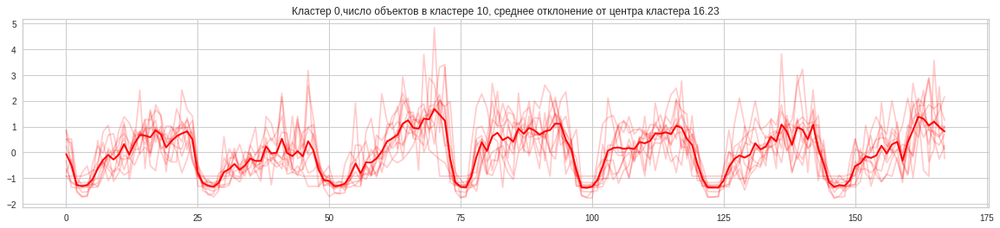

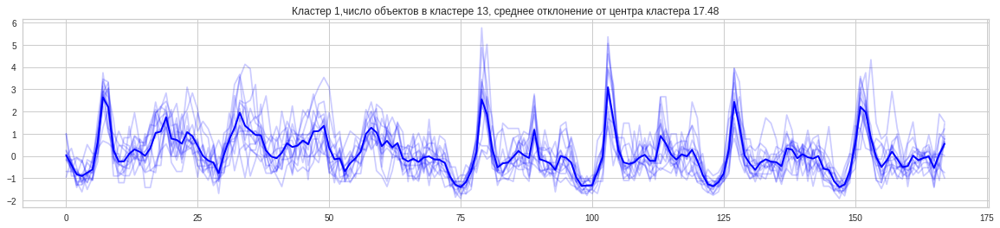

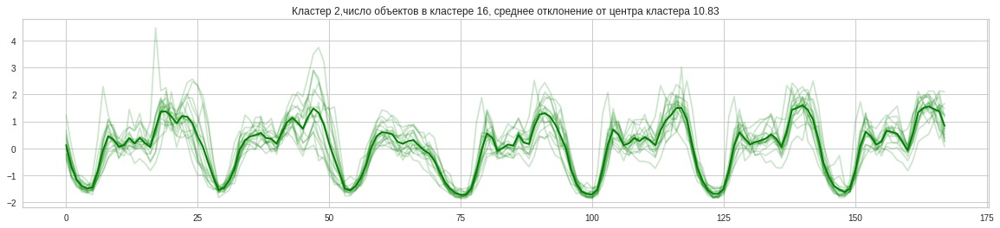

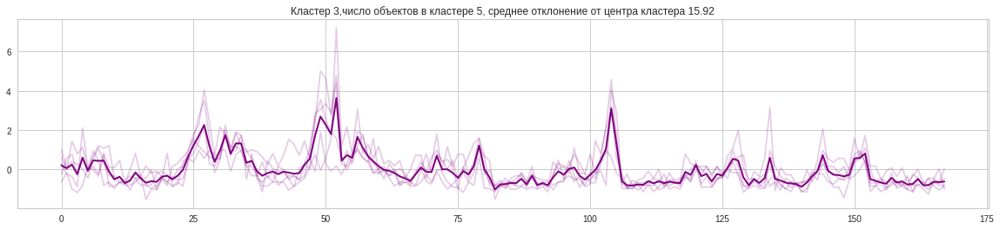

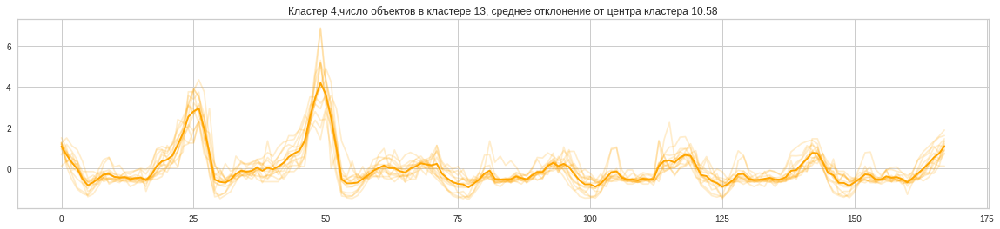

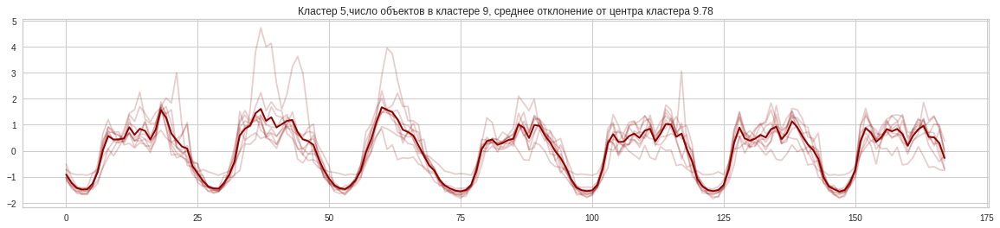

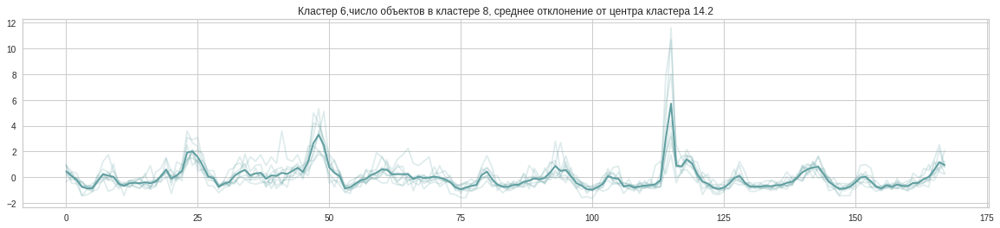

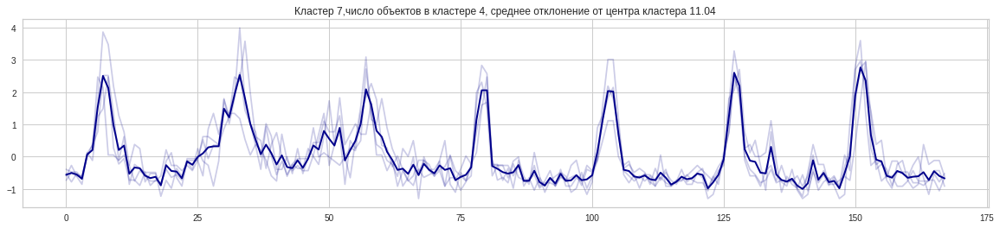

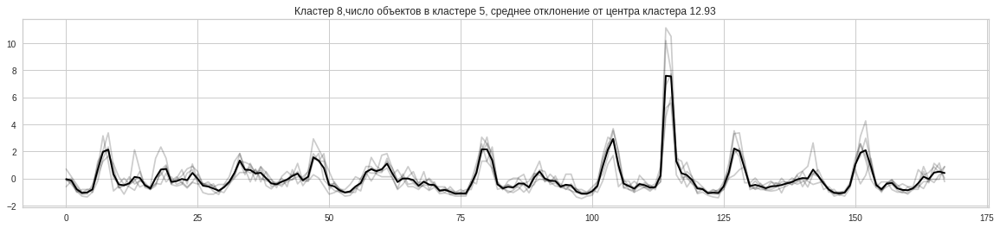

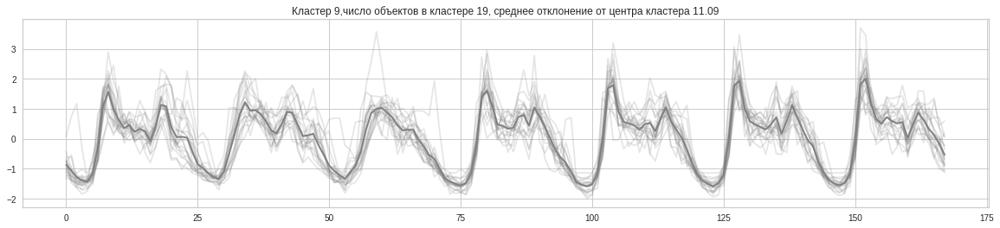

In [19]:
plot_clusters(model2,data_zones_april_normed)

Видно, что эти 10 кластеров имеют гораздо лучшее качество. Посмотрим на дендрограмму и определим, нельзя ли сократить количество кластеров, поскольку подбор 10 моделей сравнительно сложен. 

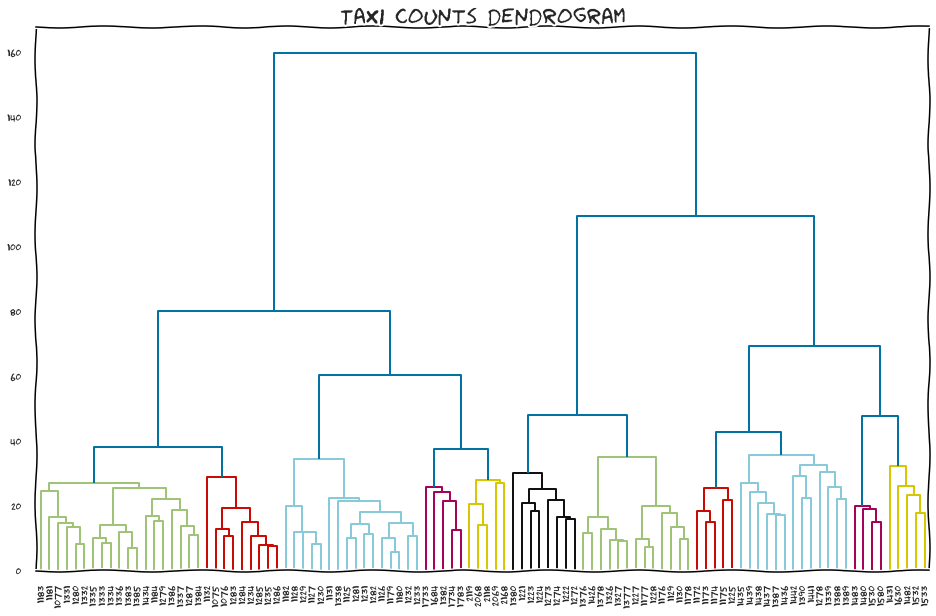

In [20]:
with plt.xkcd():
  plt.figure(figsize=(16, 10))  
  plt.title("Taxi counts dendrogram", fontsize=22)  
  dend = dendrogram(shc.linkage(data_zones_april_normed.T, method='ward'), labels=zones, color_threshold=37)  
  plt.xticks(fontsize=10)
  plt.show() 

суммарное отклонение от центров кластеров 2179.57
среднее отклонение от центров кластеров 21.37


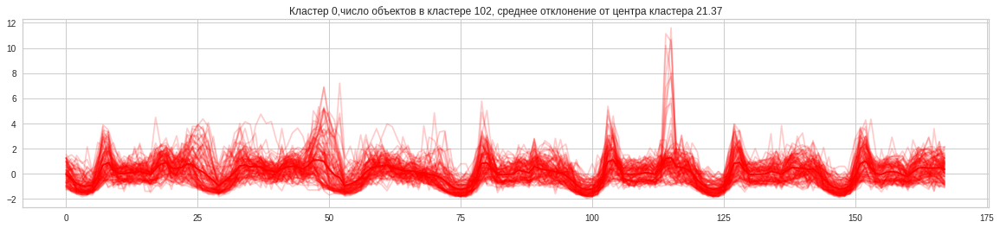

In [21]:
model3 = AgglomerativeClustering(n_clusters=1).fit(data_zones_april_normed.T)
plot_clusters(model3,data_zones_april_normed)

Видно, какое низкое качество дает 1 кластер.

суммарное отклонение от центров кластеров 1503.96
среднее отклонение от центров кластеров 14.74


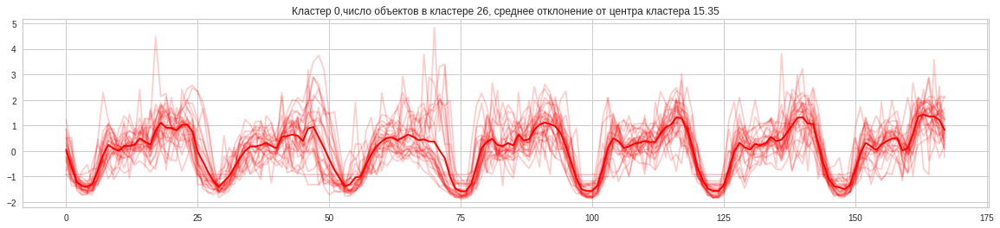

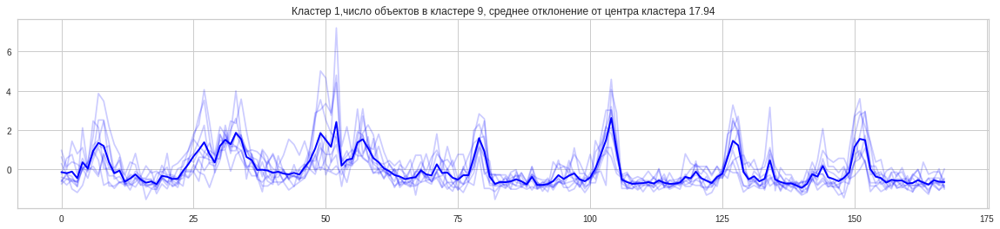

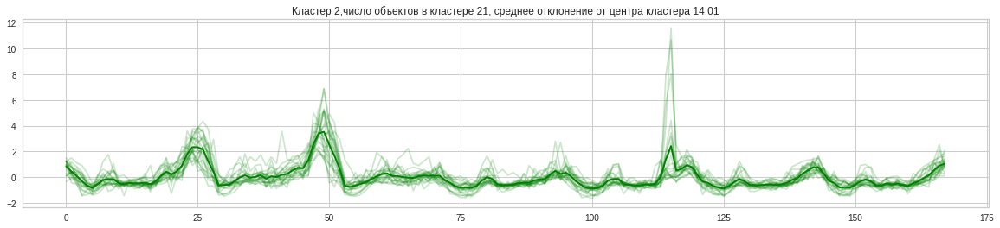

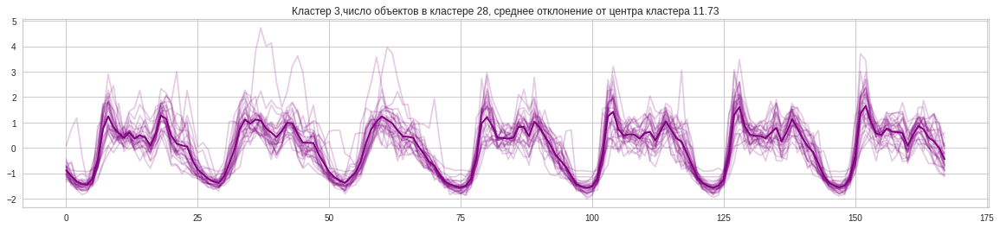

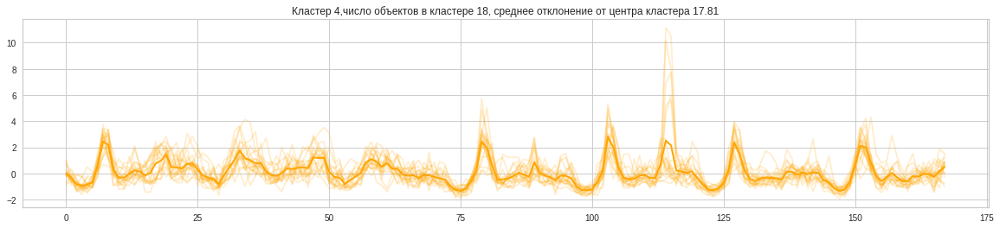

In [22]:
model4 = AgglomerativeClustering(n_clusters=5).fit(data_zones_april_normed.T)
plot_clusters(model4,data_zones_april_normed)

Итак, 5 кластеров дают достаточное качество для первого приближения.

In [23]:
model_final = model4
model_final.labels_

array([3, 3, 3, 0, 0, 0, 0, 2, 2, 0, 3, 4, 4, 4, 4, 2, 2, 2, 0, 0, 3, 0,
       3, 3, 2, 2, 2, 2, 4, 2, 2, 0, 0, 0, 0, 0, 3, 3, 2, 2, 2, 4, 3, 3,
       0, 0, 3, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 0, 4, 2, 2, 2, 2,
       0, 3, 3, 3, 3, 4, 4, 4, 4, 2, 1, 3, 4, 4, 4, 4, 4, 4, 4, 1, 1, 1,
       1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [26]:
id_cluster_df = pd.DataFrame([zones,model_final.labels_]).T
id_cluster_df.head()

,0,1
0,1075,3
1,1076,3
2,1077,3
3,1125,0
4,1126,0


In [24]:
regions = pd.read_csv(os.path.join(PATH_TO_DATA,'regions.csv'),sep=';')
regions.head()

,region,west,east,south,north
0,1,-74.25559,-74.244478,40.496120,40.504508
1,2,-74.25559,-74.244478,40.504508,40.512896
2,3,-74.25559,-74.244478,40.512896,40.521285
3,4,-74.25559,-74.244478,40.521285,40.529673
4,5,-74.25559,-74.244478,40.529673,40.538061


Построим кластеры на карте.

In [27]:
m = folium.Map(location=[40.748817,-73.985428,], zoom_start=10.5)
color_dict = {0:'red',1:'blue',2:'green',3:'purple',4:'orange',\
              5:'darkred',6:'cadetblue',7:'darkblue',8:'black',\
              9:'gray'}


for cluster_label in np.unique(model_final.labels_):

  cluster_id_list = list(id_cluster_df[id_cluster_df[1] == cluster_label][0].values)
  cluster_indices = [id - 1 for id in cluster_id_list]
  cluster_regions = regions.iloc[cluster_indices].copy()
  
  #Центры ячеек для размещения маркеров
  cluster_regions['mid_long']=cluster_regions.apply(lambda row: (row['east']+row['west'])/2,  axis=1)
  cluster_regions['mid_lat']=cluster_regions.apply(lambda row: (row['north']+row['south'])/2,  axis=1)

  taxi_markers = folium.map.FeatureGroup(name=f'Cluster {cluster_label}')

  for row in cluster_regions.values:
    id = int(row[0])   
    message = f'<i>Id: {id}</i>'
    coords = [row[-1],row[-2]]
    taxi_markers.add_children(folium.Marker(coords,
                                          popup=message,
                                          icon=folium.Icon(icon='taxi',color=color_dict[cluster_label],prefix='fa')
                                          )     
                            ) 
  taxi_markers.add_to(m)


folium.LayerControl().add_to(m)

m

Видно, что логика в разбиении присутствует, можно заметить, что аэропорты объединились в 1 кластер, также можно заметить, что центр города и окраина принадлежат разным кластерам.

Построим характерные ряды для каждого кластера (нормализованные центры), подберем модели на данных до апреля, валдация будет на апреле. Оптимальные параметры запишем в словарь.

In [28]:
time_series_4_month = time_series_6_month.loc[:pd.to_datetime('2016-04-30 23:00:00')]
time_series_4_month.tail()

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,...,2461,2462,2463,2464,2465,2466,2467,2468,2469,2470,2471,2472,2473,2474,2475,2476,2477,2478,2479,2480,2481,2482,2483,2484,2485,2486,2487,2488,2489,2490,2491,2492,2493,2494,2495,2496,2497,2498,2499,2500
2016-04-30 19:00:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2016-04-30 20:00:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2016-04-30 21:00:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2016-04-30 22:00:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2016-04-30 23:00:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [29]:
ts_normed,norm_coef = normalisation(time_series_4_month[zones])

cluster_centers = {}
for cluster_label in np.unique(model_final.labels_):
  cluster_id_list = list(id_cluster_df[id_cluster_df[1] == cluster_label][0].values)
  cluster_centers[cluster_label] = cluster_center(ts_normed[cluster_id_list])
time_series_centers = pd.DataFrame(cluster_centers)
time_series_centers.tail()

,0,1,2,3,4
2016-04-30 19:00:00,0.761015,-0.297626,0.859345,1.078947,0.595580
2016-04-30 20:00:00,0.605009,-0.191006,0.827676,0.538571,0.461754
2016-04-30 21:00:00,0.746622,-0.073146,1.427313,0.239056,0.906419
2016-04-30 22:00:00,0.809024,-0.231825,2.136064,0.209827,0.572843
2016-04-30 23:00:00,0.798873,0.736936,2.990075,0.200000,1.471648


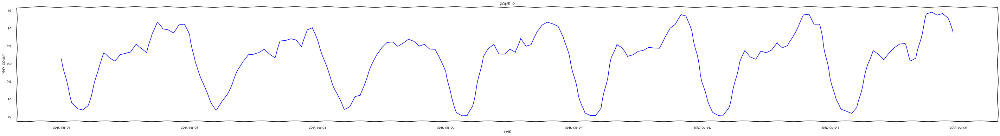

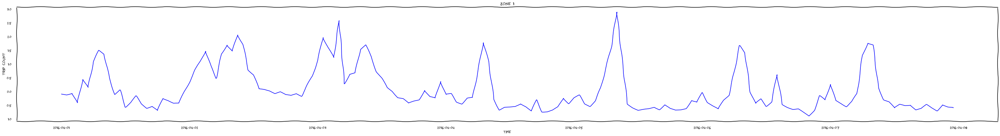

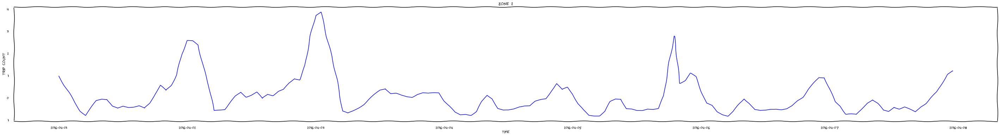

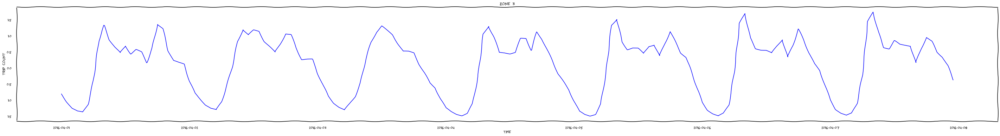

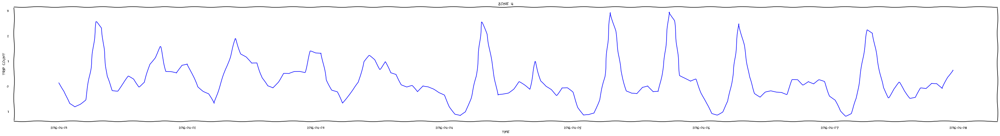

In [30]:
for col in time_series_centers.columns:
  time_series_plot(time_series_centers[col].iloc[-720:].iloc[:168],col)

In [0]:
def reg_feats(start,stop,kw=2,ky=0,linear_fe=False):
    #Вспомогательная функция для построения признаков
    
    arg = np.array([x for x in range(start,stop+1)])
    fe_list = []
    columns = []

    #Линейный признак для описания простейшего тренда
    if linear_fe:
      fe_list.append(arg) 
      columns.append('t')

    #Признаки для описания недельной сезонности
    for i in range(1,kw+1):
      fe_list.append(np.sin(arg*2*np.pi*i/168))
      columns.append(f'sin(2*pi*t*{i}/168)')
      fe_list.append(np.cos(arg*2*np.pi*i/168))
      columns.append(f'cos(2*pi*t*{i}/168)')
  
    #Признаки для описания годовой сезонности
    for j in range(1,ky+1):
      fe_list.append(np.sin(arg*2*np.pi*j/8766))
      columns.append(f'sin(2*pi*t*{j}/8766)')
      fe_list.append(np.cos(arg*2*np.pi*i/8766))
      columns.append(f'cos(2*pi*t*{j}/8766)')

    df = pd.DataFrame(fe_list).T
    df.columns = columns
    return df

In [0]:
ts0 = time_series_centers[0]
ts = ts0.copy()
ts_work = ts
ts_tr = ts_work.iloc[:-720]
ts_val = ts_work.iloc[-720:]
feats = reg_feats(1,ts_tr.shape[0],kw=3,ky=0)
feats.head()

,sin(2*pi*t*1/168),cos(2*pi*t*1/168),sin(2*pi*t*2/168),cos(2*pi*t*2/168),sin(2*pi*t*3/168),cos(2*pi*t*3/168)
0,0.037391,0.999301,0.074730,0.997204,0.111964,0.993712
1,0.074730,0.997204,0.149042,0.988831,0.222521,0.974928
2,0.111964,0.993712,0.222521,0.974928,0.330279,0.943883
3,0.149042,0.988831,0.294755,0.955573,0.433884,0.900969
4,0.185912,0.982566,0.365341,0.930874,0.532032,0.846724


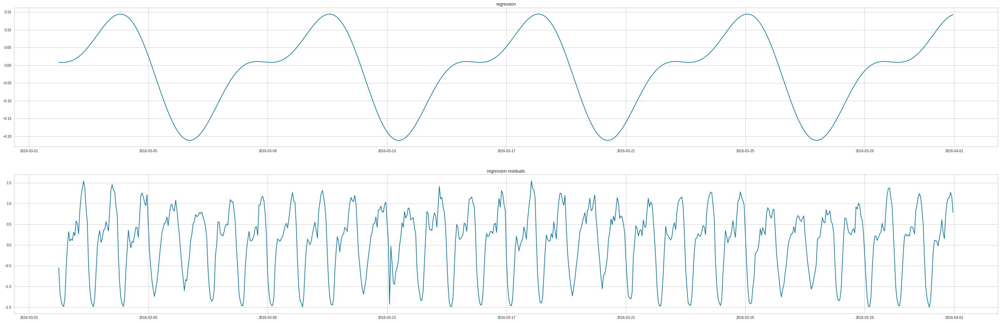

In [0]:
def reg_res_get_plot(ts,reg_features,regr=LinearRegression()):
  feats = reg_features
  regressor = regr
  regressor.fit(feats,ts)
  preds = regressor.predict(feats)
  plt.figure(figsize=(50,16))
  ax=plt.subplot(211)
  ax.plot(ts.index[-720:],preds[-720:])
  plt.title('regression');

  resids = ts - preds
  ax=plt.subplot(212)
  ax.plot(resids[-720:])
  plt.title('regression residuals');
  return resids

resids = reg_res_get_plot(ts_tr,reg_features=reg_feats(1,ts_tr.shape[0],kw=2,ky=0),regr=LinearRegression())

Критерий Дики-Фуллера: p=0.000267


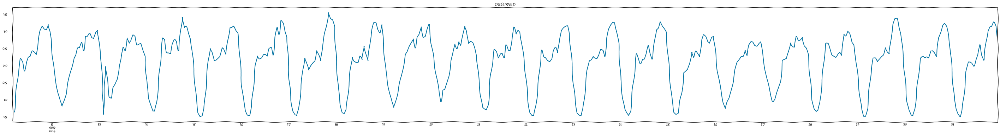

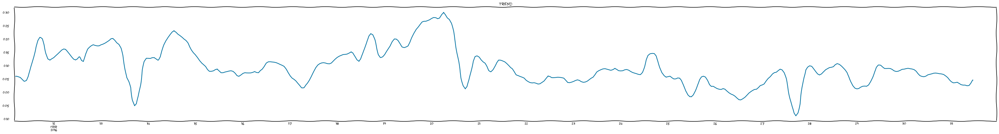

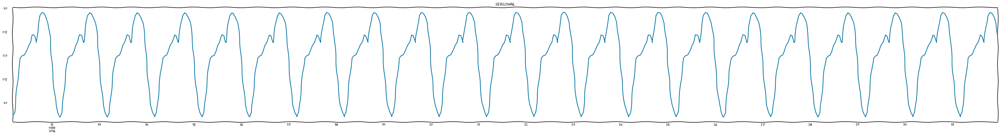

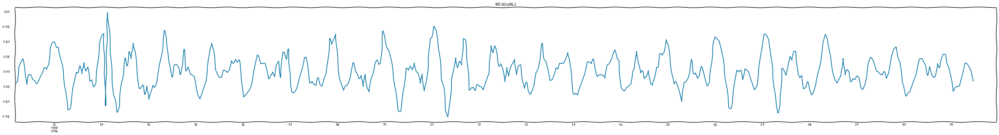

In [0]:
ts_df = resids.to_frame(name="resids")

def stl_plot(ts,lim):
  with plt.xkcd():  
    result = sm.tsa.seasonal_decompose(ts)
    plt.figure(figsize=(50,6))
    result.observed[-lim:].plot(title = 'observed')
    plt.grid(True)

    plt.figure(figsize=(50,6)) 
    result.trend[-lim:].plot(title = 'trend')
    plt.grid(True)

    plt.figure(figsize=(50,6)) 
    result.seasonal[-lim:].plot(title = 'seasonal')
    plt.grid(True)
  
    plt.figure(figsize=(50,6)) 
    result.resid[-lim:].plot(title = 'residuals')
    plt.grid(True)


stl_plot(ts_df.resids,lim=500)  
print("Критерий Дики-Фуллера: p=%f" % sm.tsa.stattools.adfuller(resids)[1])

Критерий Дики-Фуллера: p=0.000000


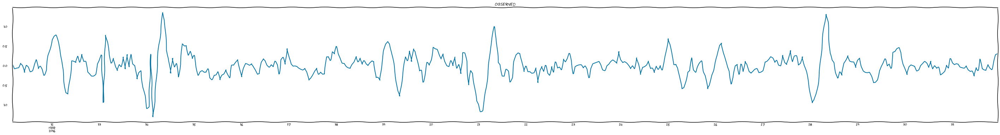

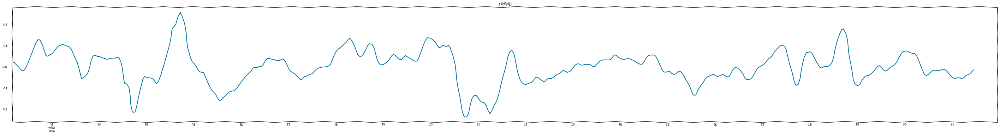

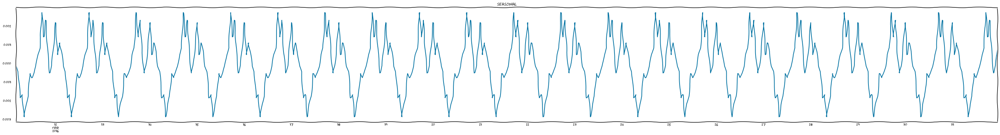

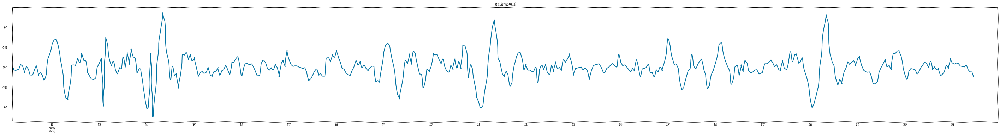

In [0]:
ts_df['diff1_resids'] = ts_df.resids - ts_df.resids.shift(24)

stl_plot(ts_df.diff1_resids[25:],lim=500)  
print("Критерий Дики-Фуллера: p=%f" % sm.tsa.stattools.adfuller(ts_df.diff1_resids[25:] )[1])

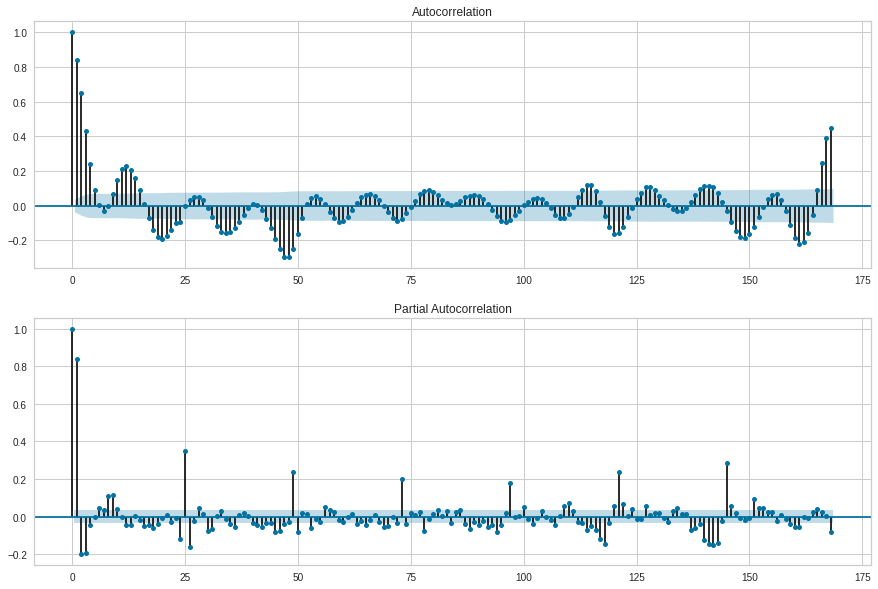

In [0]:
def acf_pacf_plot(series,n_lags):
  plt.figure(figsize=(15,10))
  ax = plt.subplot(211)
  sm.graphics.tsa.plot_acf(series.values.squeeze(), lags=n_lags, ax=ax);

  ax = plt.subplot(212)
  sm.graphics.tsa.plot_pacf(series.values.squeeze(), lags=n_lags, ax=ax);

acf_pacf_plot(ts_df.diff1_resids[25:],n_lags=168)

In [0]:
ps = range(0, 4)
d=0
qs = range(0, 4)
Ps = range(0, 2)
D=1
Qs = range(0, 3)

In [0]:
parameters = product(ps, qs, Ps, Qs)
parameters_list = list(parameters)
len(parameters_list)

96

In [0]:
class TimeSeriesModel(BaseEstimator, TransformerMixin):
  '''
  Модель для предсказания временного ряда.
  Использует регрессию на тригонометрические признаки и модель SARIMA
  '''

  def __init__(self,kw=2,ky=0,linear_fe=False,params=(1,1,1),seasonal_params=(1,1,1,24),use_yj=False):
    self.kw = kw
    self.ky = ky
    self.linear_fe = linear_fe
    self.params=params
    self.seasonal_params=seasonal_params
    self.use_yj = use_yj
    

  def reg_feats(self,start,stop,kw=2,ky=0,linear_fe=False):
    #Вспомогательная функция для построения признаков
    
    arg = np.array([x for x in range(start,stop+1)])
    fe_list = []
    columns = []

    #Линейный признак для описания простейшего тренда
    if linear_fe:
      fe_list.append(arg) 
      columns.append('t')

    #Признаки для описания недельной сезонности
    for i in range(1,kw+1):
      fe_list.append(np.sin(arg*2*np.pi*i/168))
      columns.append(f'sin(2*pi*t*{i}/168)')
      fe_list.append(np.cos(arg*2*np.pi*i/168))
      columns.append(f'cos(2*pi*t*{i}/168)')
  
    #Признаки для описания годовой сезонности
    for j in range(1,ky+1):
      fe_list.append(np.sin(arg*2*np.pi*j/8766))
      columns.append(f'sin(2*pi*t*{j}/8766)')
      fe_list.append(np.cos(arg*2*np.pi*i/8766))
      columns.append(f'cos(2*pi*t*{j}/8766)')

    df = pd.DataFrame(fe_list).T
    df.columns = columns
    return df


  def fit(self,ts,save_ar_params=False,load_ar_params=False,PATH_TO_MODELS=''):
    #Обучение, вход - df

    #Нормализация для сглаживания пиков и стабилизации дисперсии исходного ряда, если нужно
    if self.use_yj:
      self.yj = PowerTransformer(method='yeo-johnson', standardize=False, copy=True)
      self.yj.fit(ts)
      tr_ts = pd.DataFrame(self.yj.transform(ts.copy()), index=ts.index,columns=[ts.columns[0]])
      self.ts = tr_ts
    else:      
      self.ts = ts.copy()    

    #Признаки для регрессии и обучение регрессионной модели
    feats = self.reg_feats(start=1,stop=self.ts.shape[0],kw=self.kw, ky=self.ky,linear_fe=self.linear_fe)
    self.regressor = LinearRegression()
    self.regressor.fit(feats,self.ts)   
    
    #Получаем остатки регрессии для использования в SARIMA
    preds = self.regressor.predict(feats)
    resids = self.ts - preds
    
    #Загрузка или обучение авторегрессионной модели
    if load_ar_params:
      #Загрузка параметров
      ar_params = pd.read_csv(os.path.join(PATH_TO_MODELS,f'{self.ts.columns[0]}_params'),\
                              index_col=0,names=['params'],header=0).params
      ar_params.name=None    
      #фильтр (быстро)
      self.model = sm.tsa.statespace.SARIMAX(resids, order=self.params, 
                                        seasonal_order=self.seasonal_params).filter(ar_params)
    else:
      #обучение (долго)      
      self.model=sm.tsa.statespace.SARIMAX(resids, order=self.params, 
                                        seasonal_order=self.seasonal_params).fit(disp=-1)

    #Сохранение авторегрессионной модели
    if not load_ar_params and save_ar_params:
      self.model.params.to_csv(os.path.join(PATH_TO_MODELS,f'{self.ts.columns[0]}_params'))

    return self


  def extend(self,bigger_ts,refit_regressor = False):
    #Расширяет модель на более широкий диапазон данных, не переобучая SARIMAX, вход - df

    #Нормализация для сглаживания пиков и стабилизации дисперсии исходного ряда, если нужно
    if self.use_yj:
      self.yj = PowerTransformer(method='yeo-johnson', standardize=False, copy=True)
      self.yj.fit(bigger_ts)
      tr_ts = pd.DataFrame(self.yj.transform(bigger_ts.copy()), index=bigger_ts.index,columns=[bigger_ts.columns[0]])
      self.ts = tr_ts
    else:      
      self.ts = bigger_ts.copy()  

    feats = self.reg_feats(start=1,stop=self.ts.shape[0],kw=self.kw, ky=self.ky,linear_fe=self.linear_fe)

    if refit_regressor:
      self.regressor.fit(feats,self.ts)

    preds = self.regressor.predict(feats)
    resids = self.ts - preds
    new_model = sm.tsa.statespace.SARIMAX(resids, order=self.params, 
                                        seasonal_order=self.seasonal_params).filter(self.model.params)
    self.model = new_model   
    return self                        
    

  def predict(self,start,stop,verbose=False):
    #Предсказание, выход df
    #start, stop - timestamps

    #Получаем признаки регрессии для предсказания

    #Timestamps to int
    ts_index = list(self.ts.index)
    if start in ts_index:
      start_pos = ts_index.index(start) + 1
    else:
      start_pos = self.ts.shape[0] + (start - ts_index[len(ts_index)-1]).total_seconds()/3600  + 1
    stop_pos = start_pos + (stop - start).total_seconds()/3600
    
    feats = self.reg_feats(int(start_pos),int(stop_pos),self.kw,self.ky,self.linear_fe)

    #Предсказание регрессии
    pred_regression = self.regressor.predict(feats)
    #Предсказание SARIMA
    pred_resids = self.model.predict(start=start, end=stop)
    #Итоговое предсказание как суперпозиция    
    result = pd.DataFrame(pred_resids) + pred_regression
    result.columns = [f'{self.ts.columns[0]}_forecast']

    if self.use_yj:
      index = result.index
      result = pd.DataFrame(self.yj.inverse_transform(result),index = index,columns=[f'{self.ts.columns[0]}_forecast'])
    
    if verbose:
      plt.figure()
      plt.plot(pd.DataFrame(pred_resids,index = result.index),color='g')#график предсказанных остатков для отладки      
      plt.plot(pd.DataFrame(pred_regression,index = result.index),color='r') #график регрессии для отладки       

    return result 


In [0]:
lim = 168
results = []
best_aic = float("inf")
warnings.filterwarnings('ignore')

for param in tqdm_notebook(parameters_list):
    #try except нужен, потому что на некоторых наборах параметров модель не обучается
    try:
        model = sm.tsa.statespace.SARIMAX(resids[-lim:], order=(param[0], d, param[1]), 
                                        seasonal_order=(param[2], D, param[3], 24)).fit(disp=-1)
        
    #выводим параметры, на которых модель не обучается и переходим к следующему набору
    except ValueError:
        print('wrong parameters:', param)
        continue
    aic = model.aic
    #сохраняем лучшую модель, aic, параметры
    if aic < best_aic:
        best_model = model
        best_aic = aic
        best_param = param
    results.append([param, model.aic])
    
warnings.filterwarnings('default')

wrong parameters: (0, 0, 0, 2)
wrong parameters: (0, 0, 1, 2)
wrong parameters: (0, 1, 0, 2)
wrong parameters: (0, 1, 1, 2)
wrong parameters: (0, 2, 0, 2)
wrong parameters: (0, 2, 1, 2)
wrong parameters: (0, 3, 0, 2)
wrong parameters: (0, 3, 1, 2)
wrong parameters: (1, 0, 0, 2)
wrong parameters: (1, 0, 1, 2)
wrong parameters: (1, 1, 0, 2)
wrong parameters: (1, 1, 1, 2)
wrong parameters: (1, 2, 0, 2)
wrong parameters: (1, 2, 1, 2)
wrong parameters: (1, 3, 0, 2)
wrong parameters: (1, 3, 1, 2)
wrong parameters: (2, 0, 0, 2)
wrong parameters: (2, 0, 1, 2)
wrong parameters: (2, 1, 0, 2)
wrong parameters: (2, 1, 1, 2)
wrong parameters: (2, 2, 0, 2)
wrong parameters: (2, 2, 1, 2)
wrong parameters: (2, 3, 0, 2)
wrong parameters: (2, 3, 1, 2)
wrong parameters: (3, 0, 0, 2)
wrong parameters: (3, 0, 1, 2)
wrong parameters: (3, 1, 0, 2)
wrong parameters: (3, 1, 1, 2)
wrong parameters: (3, 2, 0, 2)
wrong parameters: (3, 2, 1, 2)
wrong parameters: (3, 3, 0, 2)
wrong parameters: (3, 3, 1, 2)



In [0]:
result_table = pd.DataFrame(results)
result_table.columns = ['parameters', 'aic']
print(result_table.sort_values(by = 'aic', ascending=True)[:10])

      parameters         aic
39  (2, 1, 1, 1) -145.726674
37  (2, 1, 0, 1) -144.051522
55  (3, 1, 1, 1) -143.788214
43  (2, 2, 1, 1) -143.773139
47  (2, 3, 1, 1) -143.600655
63  (3, 3, 1, 1) -142.388407
41  (2, 2, 0, 1) -142.077569
53  (3, 1, 0, 1) -142.075276
59  (3, 2, 1, 1) -141.741261
51  (3, 0, 1, 1) -141.685539


In [0]:
model = TimeSeriesModel(kw=2,ky=0,linear_fe=False,params=(best_param[0],d,best_param[1]),seasonal_params=(best_param[2],D,best_param[3],24),use_yj=False)

In [0]:
%%time
model.fit(pd.DataFrame(ts_tr[-720:]))
print(model.model.summary())

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  % freq, ValueWarning)
/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/statespace/sarimax.py:949: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/statespace/sarimax.py:961: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


                                 Statespace Model Results                                 
Dep. Variable:                                  0   No. Observations:                  720
Model:             SARIMAX(2, 0, 1)x(1, 1, 1, 24)   Log Likelihood                 267.961
Date:                            Mon, 25 May 2020   AIC                           -523.923
Time:                                    12:01:35   BIC                           -496.650
Sample:                                03-02-2016   HQIC                          -513.378
                                     - 03-31-2016                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.6117      0.038     42.194      0.000       1.537       1.687
ar.L2         -0.7530      0.031   

Критерий Стьюдента: p=0.430078
Критерий Дики-Фуллера: p=0.000000


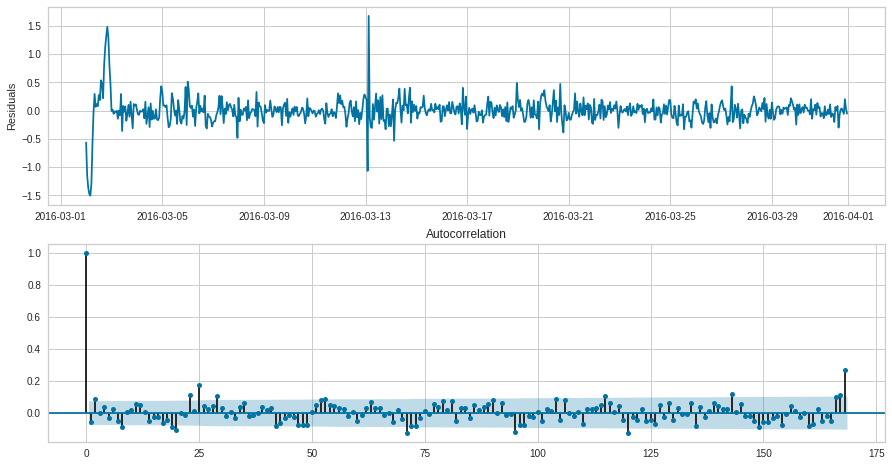

In [0]:
plt.figure(figsize=(15,8))
ax = plt.subplot(211)
ax.plot(model.model.resid[-720:])
plt.ylabel('Residuals')

ax = plt.subplot(212)
sm.graphics.tsa.plot_acf(model.model.resid[25:].squeeze(), lags=168, ax=ax)

print("Критерий Стьюдента: p=%f" % stats.ttest_1samp(model.model.resid[25:], 0)[1])
print("Критерий Дики-Фуллера: p=%f" % sm.tsa.stattools.adfuller(model.model.resid[25:])[1])

/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)


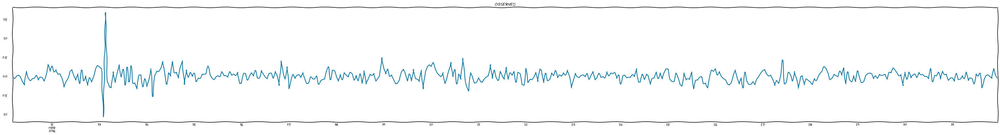

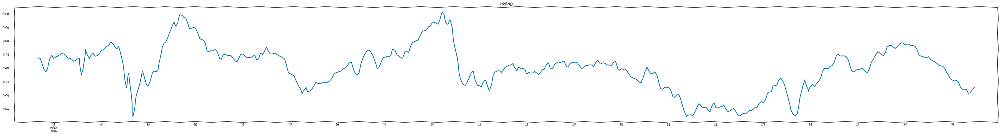

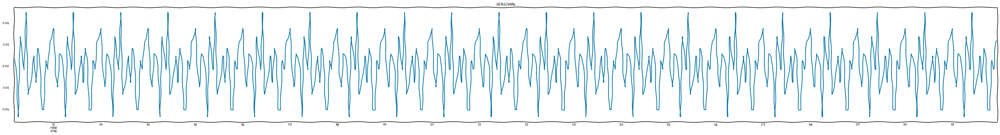

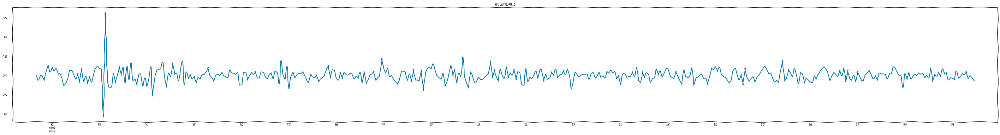

In [0]:
index=[pd.to_datetime(tt) for tt in ts_tr.index[-500:]]
ts_resids= pd.Series(model.model.resid[-500:],index=index)
stl_plot(ts_resids,lim=500)

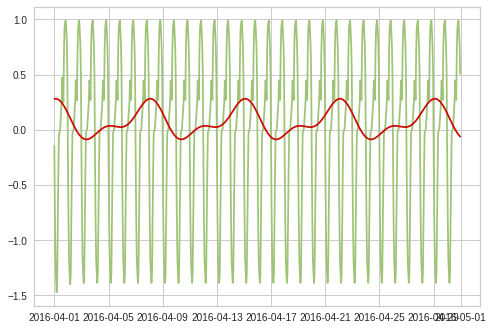

In [0]:
prediction = model.predict(pd.to_datetime('2016-04-01 00:00:00'),pd.to_datetime('2016-04-30 23:00:00'),verbose=True)

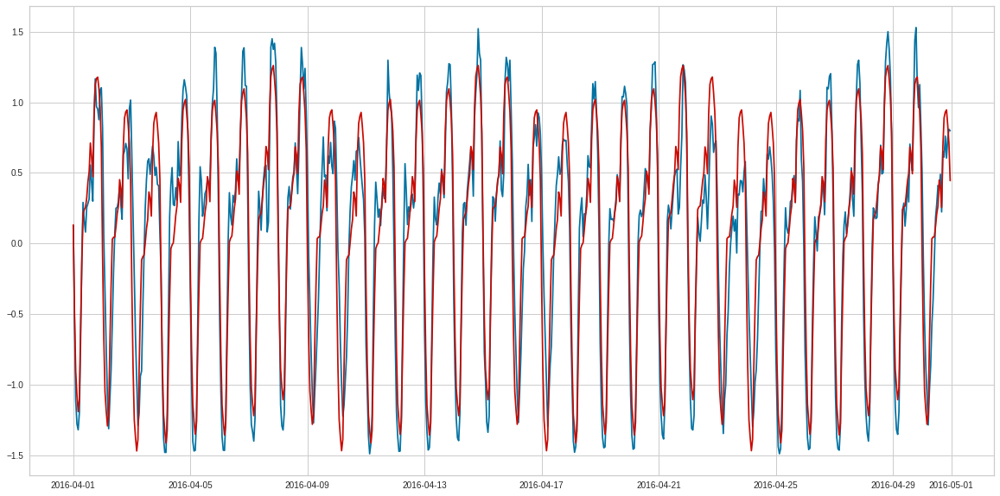

In [0]:
plt.figure(figsize=(20,10))
plt.plot(ts_val,color='b')
plt.plot(ts_val.index,prediction,color='r');


In [0]:
error = mae(ts_val,prediction)
error

0.21628633691699864

In [0]:
'''
cluster0_params:
kw=2
SARIMAX(2, 0, 1)x(1, 1, 1, 24)
use_yj=False
'''

'\ncluster0_params:\nkw=2\nSARIMAX(3, 0, 1)x(1, 1, 1, 24)\nuse_yj=False\n'

In [0]:
cl0_model_params= {'kw':2,
                  'params':(2, 0, 1),
                  'seasonal_params':(1, 1, 1, 24),
                  'use_yj':False
                  }

In [0]:
ts1 = time_series_centers[1]
ts = ts1.copy()
yj = PowerTransformer(method='yeo-johnson', standardize=False, copy=True)
yj.fit(ts.values.reshape(-1,1))
ts_work = pd.Series(yj.transform(ts.values.reshape(-1,1)).reshape(-1),index=ts.index)
ts_tr = ts_work.iloc[:-720]
ts_val = ts_work.iloc[-720:]
feats = reg_feats(1,ts_tr.shape[0],kw=3,ky=0)
feats.head()

,sin(2*pi*t*1/168),cos(2*pi*t*1/168),sin(2*pi*t*2/168),cos(2*pi*t*2/168),sin(2*pi*t*3/168),cos(2*pi*t*3/168)
0,0.037391,0.999301,0.074730,0.997204,0.111964,0.993712
1,0.074730,0.997204,0.149042,0.988831,0.222521,0.974928
2,0.111964,0.993712,0.222521,0.974928,0.330279,0.943883
3,0.149042,0.988831,0.294755,0.955573,0.433884,0.900969
4,0.185912,0.982566,0.365341,0.930874,0.532032,0.846724


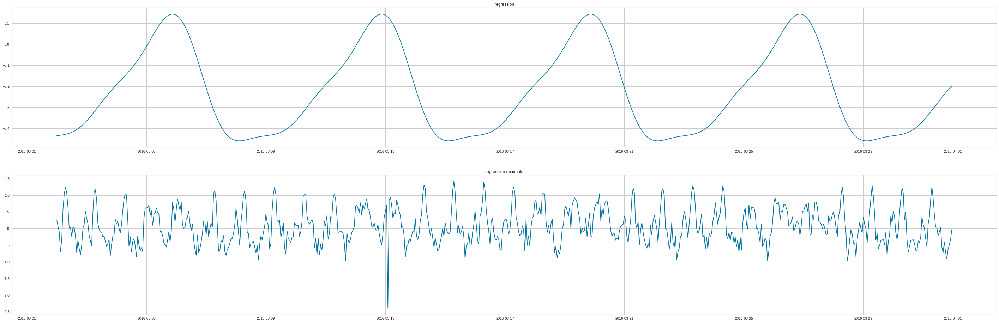

In [0]:
resids = reg_res_get_plot(ts_tr,reg_features=reg_feats(1,ts_tr.shape[0],kw=3,ky=0),regr=LinearRegression())

Критерий Дики-Фуллера: p=0.000000


/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)


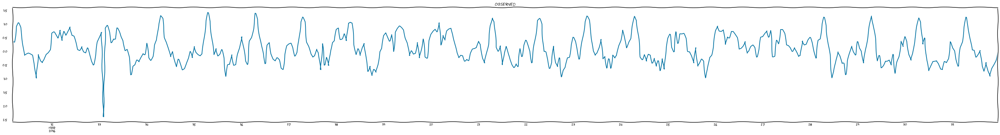

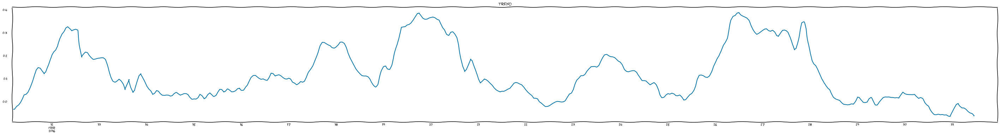

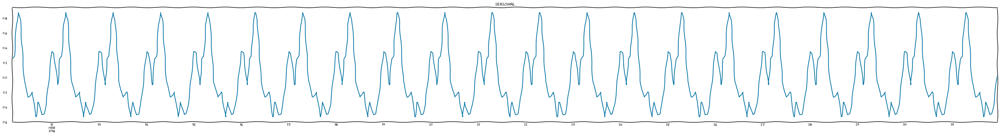

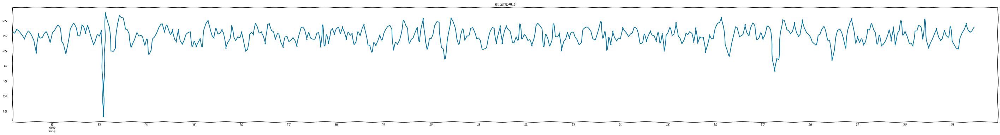

In [0]:
ts_df = resids.to_frame(name="resids")

stl_plot(ts_df.resids,lim=500)  
print("Критерий Дики-Фуллера: p=%f" % sm.tsa.stattools.adfuller(resids)[1])

Критерий Дики-Фуллера: p=0.000000


/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)


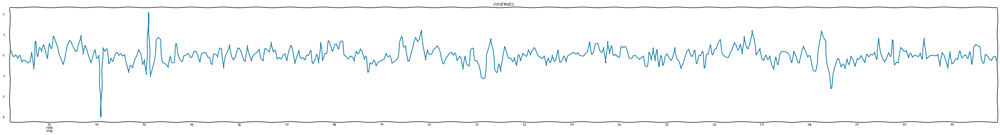

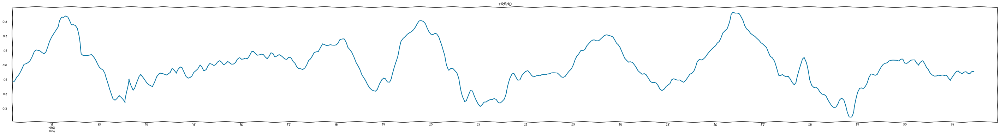

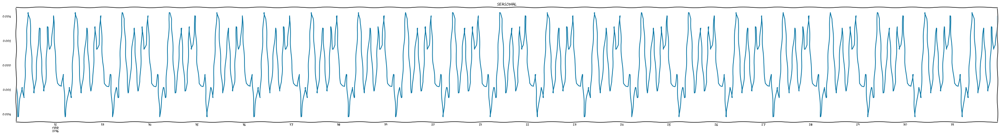

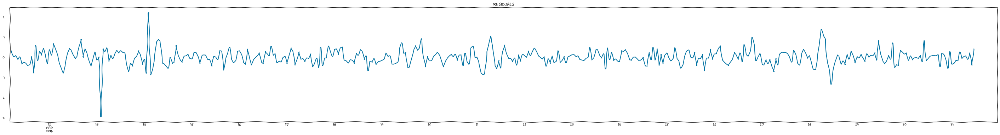

In [0]:
ts_df['diff1_resids'] = ts_df.resids - ts_df.resids.shift(24)

stl_plot(ts_df.diff1_resids[25:],lim=500)  
print("Критерий Дики-Фуллера: p=%f" % sm.tsa.stattools.adfuller(ts_df.diff1_resids[25:] )[1])

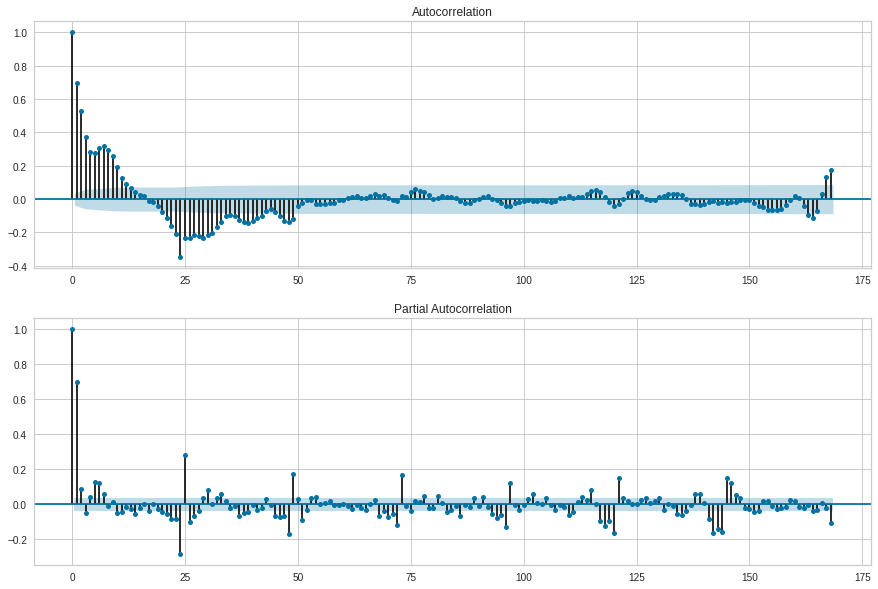

In [0]:
acf_pacf_plot(ts_df.diff1_resids[25:],n_lags=168)

In [0]:
ps = range(0, 2)
d=0
qs = range(0, 4)
Ps = range(0, 4)
D=1
Qs = range(0, 2)

In [0]:
parameters = product(ps, qs, Ps, Qs)
parameters_list = list(parameters)
len(parameters_list)

64

In [0]:
lim = 168
results = []
best_aic = float("inf")
warnings.filterwarnings('ignore')

for param in tqdm_notebook(parameters_list):
    #try except нужен, потому что на некоторых наборах параметров модель не обучается
    try:
        model = sm.tsa.statespace.SARIMAX(resids[-lim:], order=(param[0], d, param[1]), 
                                        seasonal_order=(param[2], D, param[3], 24)).fit(disp=-1)        
    #выводим параметры, на которых модель не обучается и переходим к следующему набору
    except ValueError:
        print('wrong parameters:', param)
        continue
    aic = model.aic
    #сохраняем лучшую модель, aic, параметры
    if aic < best_aic:
        best_model = model
        best_aic = aic
        best_param = param
    results.append([param, model.aic])
    
warnings.filterwarnings('default')

In [0]:
result_table = pd.DataFrame(results)
result_table.columns = ['parameters', 'aic']
print(result_table.sort_values(by = 'aic', ascending=True)[:10])

      parameters        aic
25  (0, 3, 0, 1)  73.875234
33  (1, 0, 0, 1)  74.750976
49  (1, 2, 0, 1)  74.787514
55  (1, 2, 3, 1)  75.409872
27  (0, 3, 1, 1)  75.513426
57  (1, 3, 0, 1)  75.688665
51  (1, 2, 1, 1)  76.149432
35  (1, 0, 1, 1)  76.216369
41  (1, 1, 0, 1)  76.345459
63  (1, 3, 3, 1)  77.055978


In [0]:
model = TimeSeriesModel(kw=3,ky=0,linear_fe=False,params=(best_param[0],d,best_param[1]),seasonal_params=(best_param[2],D,best_param[3],24),use_yj=True)

In [0]:
%%time
model.fit(pd.DataFrame(ts_tr[-720:]))
print(model.model.summary())

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  % freq, ValueWarning)


                                 Statespace Model Results                                 
Dep. Variable:                                  0   No. Observations:                  720
Model:             SARIMAX(0, 0, 3)x(0, 1, 1, 24)   Log Likelihood                -158.261
Date:                            Mon, 25 May 2020   AIC                            326.522
Time:                                    12:38:25   BIC                            349.249
Sample:                                03-02-2016   HQIC                           335.309
                                     - 03-31-2016                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.3997      0.015     26.194      0.000       0.370       0.430
ma.L2          0.2469      0.034   

Критерий Стьюдента: p=0.090916
Критерий Дики-Фуллера: p=0.000000


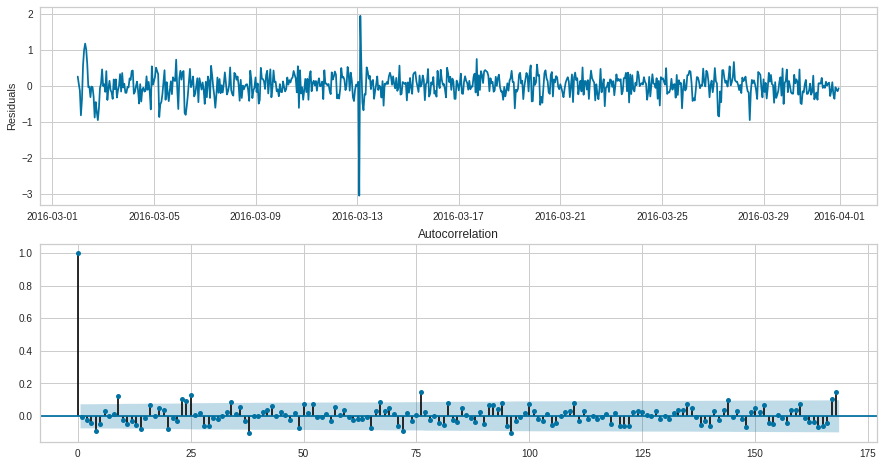

In [0]:
plt.figure(figsize=(15,8))
ax = plt.subplot(211)
ax.plot(model.model.resid[-720:])
plt.ylabel('Residuals')

ax = plt.subplot(212)
sm.graphics.tsa.plot_acf(model.model.resid[25:].squeeze(), lags=168, ax=ax)

print("Критерий Стьюдента: p=%f" % stats.ttest_1samp(model.model.resid[25:], 0)[1])
print("Критерий Дики-Фуллера: p=%f" % sm.tsa.stattools.adfuller(model.model.resid[25:])[1])

/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)


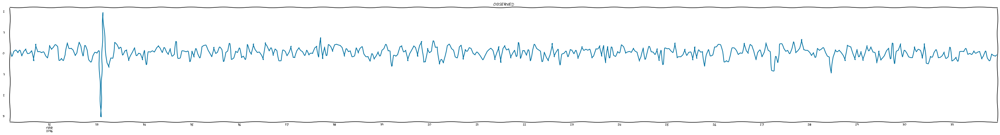

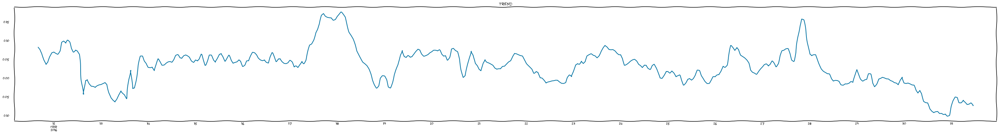

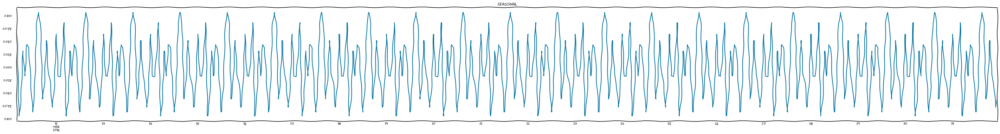

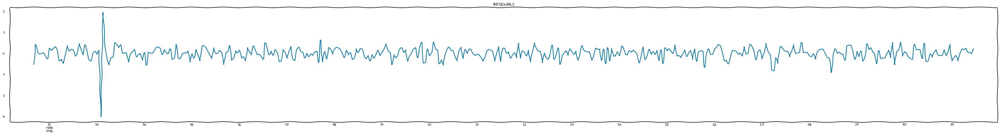

In [0]:
index=[pd.to_datetime(tt) for tt in ts_tr.index[-500:]]
ts_resids= pd.Series(model.model.resid[-500:],index=index)
stl_plot(ts_resids,lim=500)

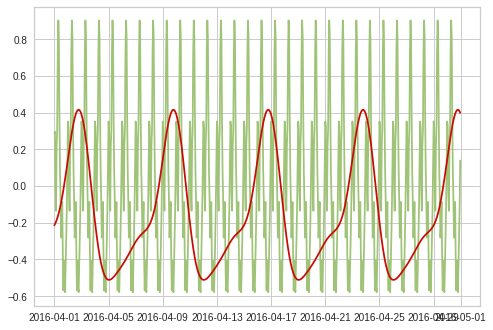

In [0]:
prediction = model.predict(pd.to_datetime('2016-04-01 00:00:00'),pd.to_datetime('2016-04-30 23:00:00'),verbose=True)

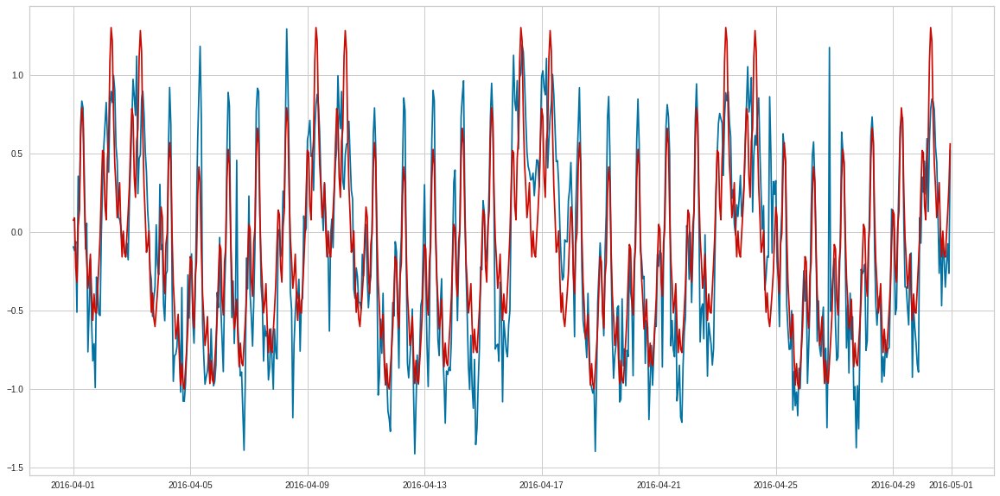

In [0]:
plt.figure(figsize=(20,10))
plt.plot(ts_val,color='b')
plt.plot(ts_val.index,prediction,color='r');


In [0]:
error = mae(ts_val,prediction)
error

0.24132928569727025

In [0]:
'''
cluster1_params:
kw=3
SARIMAX(0, 0, 3)x(0, 1, 1, 24)
use_yj=True
'''

'\ncluster1_params:\nkw=3\nSARIMAX(0, 0, 3)x(0, 1, 1, 24)\nuse_yj=True\n'

In [0]:
cl1_model_params= {'kw':3,
                  'params':(0, 0, 3),
                  'seasonal_params':(0, 1, 1, 24),
                  'use_yj':True
                  }

In [0]:
ts2 = time_series_centers[2]
ts = ts2.copy()
yj = PowerTransformer(method='yeo-johnson', standardize=False, copy=True)
yj.fit(ts.values.reshape(-1,1))
ts_work = pd.Series(yj.transform(ts.values.reshape(-1,1)).reshape(-1),index=ts.index)
ts_tr = ts_work.iloc[:-720]
ts_val = ts_work.iloc[-720:]
feats = reg_feats(1,ts_tr.shape[0],kw=3,ky=0)
feats.head()

,sin(2*pi*t*1/168),cos(2*pi*t*1/168),sin(2*pi*t*2/168),cos(2*pi*t*2/168),sin(2*pi*t*3/168),cos(2*pi*t*3/168)
0,0.037391,0.999301,0.074730,0.997204,0.111964,0.993712
1,0.074730,0.997204,0.149042,0.988831,0.222521,0.974928
2,0.111964,0.993712,0.222521,0.974928,0.330279,0.943883
3,0.149042,0.988831,0.294755,0.955573,0.433884,0.900969
4,0.185912,0.982566,0.365341,0.930874,0.532032,0.846724


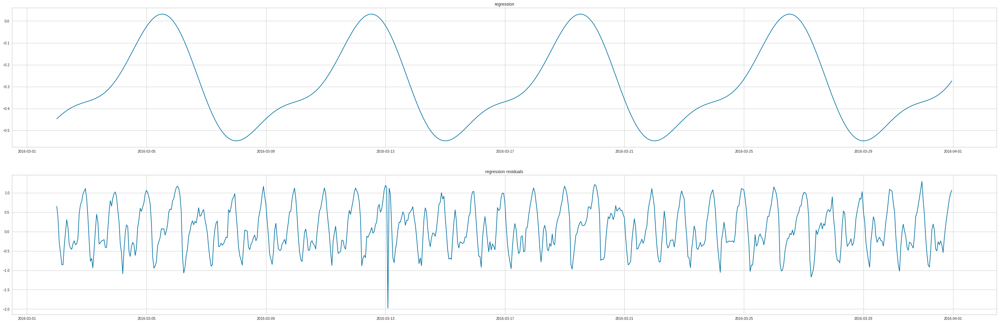

In [0]:
resids = reg_res_get_plot(ts_tr,reg_features=reg_feats(1,ts_tr.shape[0],kw=2,ky=0),regr=LinearRegression())

Критерий Дики-Фуллера: p=0.000000


/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)


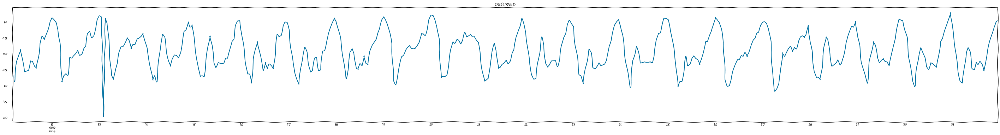

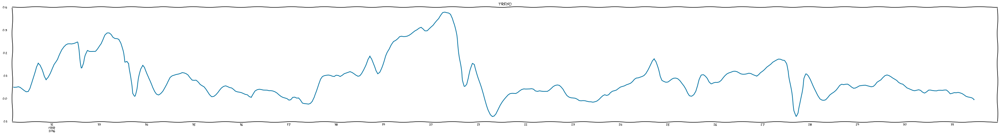

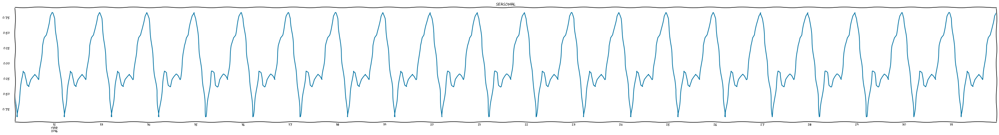

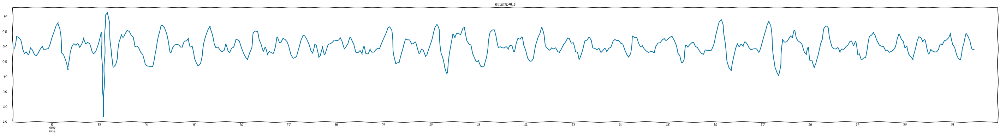

In [0]:
ts_df = resids.to_frame(name="resids")

stl_plot(ts_df.resids,lim=500)  
print("Критерий Дики-Фуллера: p=%f" % sm.tsa.stattools.adfuller(resids)[1])

Критерий Дики-Фуллера: p=0.000000


/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)


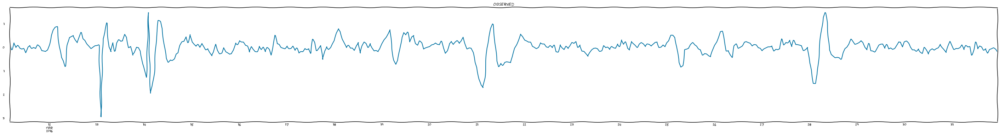

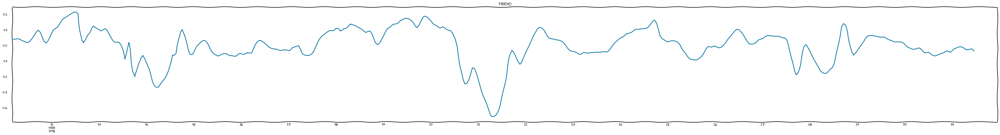

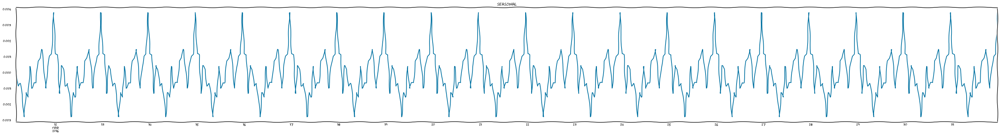

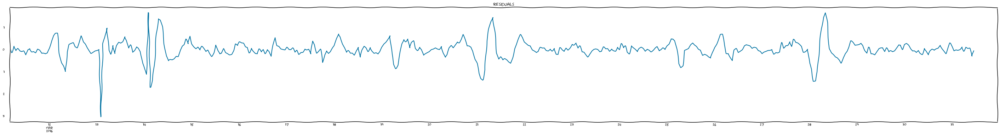

In [0]:
ts_df['diff1_resids'] = ts_df.resids - ts_df.resids.shift(24)

stl_plot(ts_df.diff1_resids[25:],lim=500)  
print("Критерий Дики-Фуллера: p=%f" % sm.tsa.stattools.adfuller(ts_df.diff1_resids[25:] )[1])

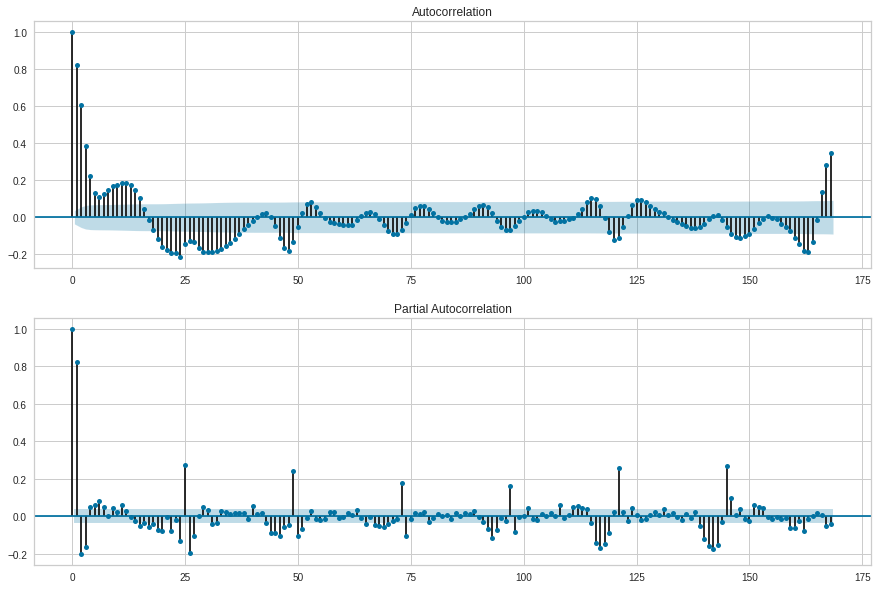

In [0]:
acf_pacf_plot(ts_df.diff1_resids[25:],n_lags=168)

In [0]:
ps = range(0, 3)
d=0
qs = range(0, 4)
Ps = range(0, 2)
D=1
Qs = range(0, 3)

In [0]:
parameters = product(ps, qs, Ps, Qs)
parameters_list = list(parameters)
len(parameters_list)

72

In [0]:
lim = 168
results = []
best_aic = float("inf")
warnings.filterwarnings('ignore')

for param in tqdm_notebook(parameters_list):
    #try except нужен, потому что на некоторых наборах параметров модель не обучается
    try:
        model = sm.tsa.statespace.SARIMAX(resids[-lim:], order=(param[0], d, param[1]), 
                                        seasonal_order=(param[2], D, param[3], 24)).fit(disp=-1)        
    #выводим параметры, на которых модель не обучается и переходим к следующему набору
    except ValueError:
        print('wrong parameters:', param)
        continue
    aic = model.aic
    #сохраняем лучшую модель, aic, параметры
    if aic < best_aic:
        best_model = model
        best_aic = aic
        best_param = param
    results.append([param, model.aic])
    
warnings.filterwarnings('default')

wrong parameters: (0, 0, 0, 2)
wrong parameters: (0, 0, 1, 2)
wrong parameters: (0, 1, 0, 2)
wrong parameters: (0, 1, 1, 2)
wrong parameters: (0, 2, 0, 2)
wrong parameters: (0, 2, 1, 2)
wrong parameters: (0, 3, 0, 2)
wrong parameters: (0, 3, 1, 2)
wrong parameters: (1, 0, 0, 2)
wrong parameters: (1, 0, 1, 2)
wrong parameters: (1, 1, 0, 2)
wrong parameters: (1, 1, 1, 2)
wrong parameters: (1, 2, 0, 2)
wrong parameters: (1, 2, 1, 2)
wrong parameters: (1, 3, 0, 2)
wrong parameters: (1, 3, 1, 2)
wrong parameters: (2, 0, 0, 2)
wrong parameters: (2, 0, 1, 2)
wrong parameters: (2, 1, 0, 2)
wrong parameters: (2, 1, 1, 2)
wrong parameters: (2, 2, 0, 2)
wrong parameters: (2, 2, 1, 2)
wrong parameters: (2, 3, 0, 2)
wrong parameters: (2, 3, 1, 2)



In [0]:
result_table = pd.DataFrame(results)
result_table.columns = ['parameters', 'aic']
print(result_table.sort_values(by = 'aic', ascending=True)[:10])

      parameters        aic
39  (2, 1, 1, 1) -83.762278
43  (2, 2, 1, 1) -81.767049
47  (2, 3, 1, 1) -80.361798
37  (2, 1, 0, 1) -78.460904
41  (2, 2, 0, 1) -76.463576
45  (2, 3, 0, 1) -75.231249
35  (2, 0, 1, 1) -70.699171
38  (2, 1, 1, 0) -68.299097
42  (2, 2, 1, 0) -66.372361
33  (2, 0, 0, 1) -65.111482


In [0]:
model = TimeSeriesModel(kw=2,ky=0,linear_fe=False,params=(best_param[0],d,best_param[1]),seasonal_params=(best_param[2],D,best_param[3],24),use_yj=True)

In [0]:
%%time
model.fit(pd.DataFrame(ts_tr[-720:]))
print(model.model.summary())

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  % freq, ValueWarning)
/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/statespace/sarimax.py:949: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/statespace/sarimax.py:961: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


                                 Statespace Model Results                                 
Dep. Variable:                                  0   No. Observations:                  720
Model:             SARIMAX(2, 0, 1)x(1, 1, 1, 24)   Log Likelihood                 -11.198
Date:                            Mon, 25 May 2020   AIC                             34.397
Time:                                    12:58:48   BIC                             61.669
Sample:                                03-02-2016   HQIC                            44.942
                                     - 03-31-2016                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.4971      0.042     35.876      0.000       1.415       1.579
ar.L2         -0.6854      0.030   

Критерий Стьюдента: p=0.988209
Критерий Дики-Фуллера: p=0.000000


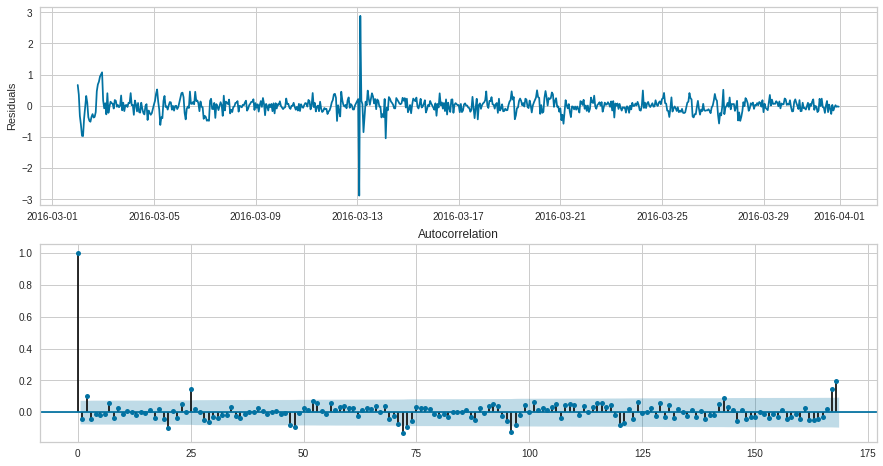

In [0]:
plt.figure(figsize=(15,8))
ax = plt.subplot(211)
ax.plot(model.model.resid[-720:])
plt.ylabel('Residuals')

ax = plt.subplot(212)
sm.graphics.tsa.plot_acf(model.model.resid[25:].squeeze(), lags=168, ax=ax)

print("Критерий Стьюдента: p=%f" % stats.ttest_1samp(model.model.resid[25:], 0)[1])
print("Критерий Дики-Фуллера: p=%f" % sm.tsa.stattools.adfuller(model.model.resid[25:])[1])

/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)


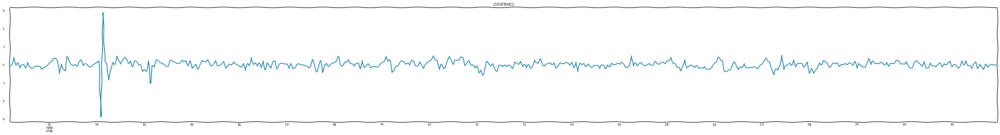

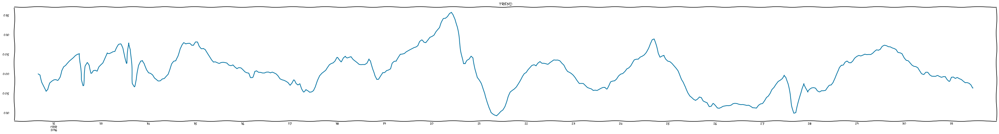

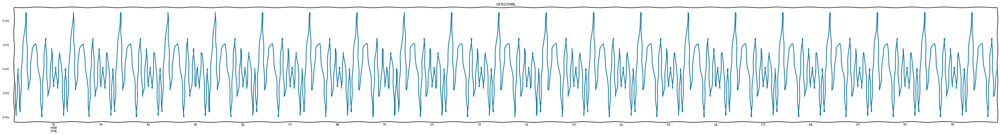

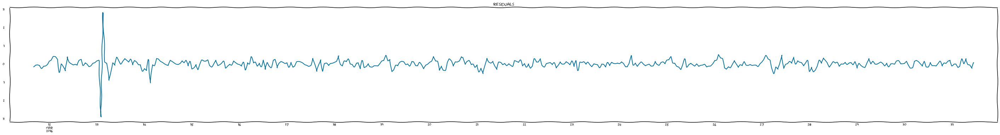

In [0]:
index=[pd.to_datetime(tt) for tt in ts_tr.index[-500:]]
ts_resids= pd.Series(model.model.resid[-500:],index=index)
stl_plot(ts_resids,lim=500)

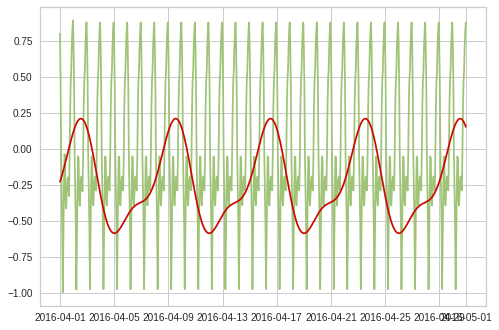

In [0]:
prediction = model.predict(pd.to_datetime('2016-04-01 00:00:00'),pd.to_datetime('2016-04-30 23:00:00'),verbose=True)

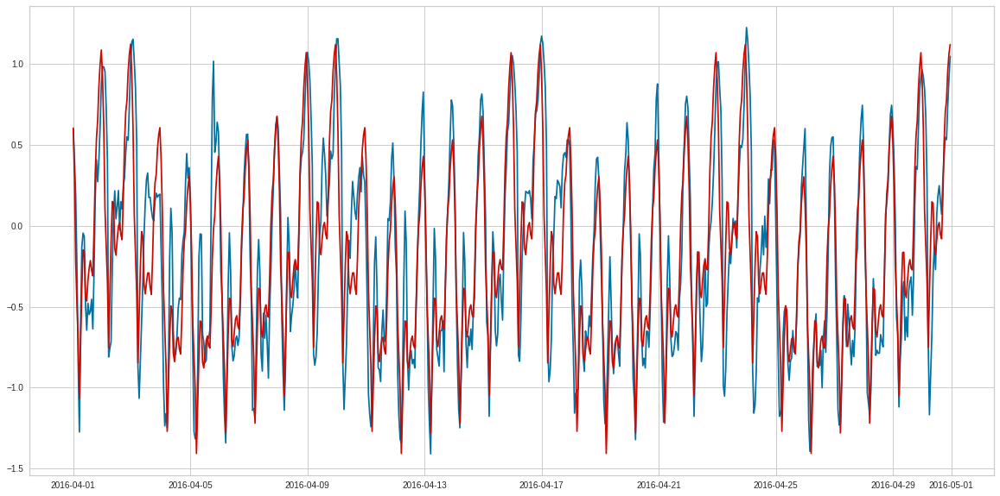

In [0]:
plt.figure(figsize=(20,10))
plt.plot(ts_val,color='b')
plt.plot(ts_val.index,prediction,color='r');


In [0]:
error = mae(ts_val,prediction)
error

0.23819513391620126

In [0]:
'''
cluster2_params:
kw=2
SARIMAX(2, 0, 1)x(1, 1, 1, 24)
use_yj=True
'''

'\ncluster2_params:\nkw=2\nSARIMAX(2, 0, 1)x(1, 1, 1, 24)\nuse_yj=True\n'

In [0]:
cl2_model_params= {'kw':2,
                  'params':(2, 0, 1),
                  'seasonal_params':(1, 1, 1, 24),
                  'use_yj':True
                  }

In [0]:
ts3 = time_series_centers[3]
ts = ts3.copy()
ts_work = ts
ts_tr = ts_work.iloc[:-720]
ts_val = ts_work.iloc[-720:]
feats = reg_feats(1,ts_tr.shape[0],kw=3,ky=0)
feats.head()

,sin(2*pi*t*1/168),cos(2*pi*t*1/168),sin(2*pi*t*2/168),cos(2*pi*t*2/168),sin(2*pi*t*3/168),cos(2*pi*t*3/168)
0,0.037391,0.999301,0.074730,0.997204,0.111964,0.993712
1,0.074730,0.997204,0.149042,0.988831,0.222521,0.974928
2,0.111964,0.993712,0.222521,0.974928,0.330279,0.943883
3,0.149042,0.988831,0.294755,0.955573,0.433884,0.900969
4,0.185912,0.982566,0.365341,0.930874,0.532032,0.846724


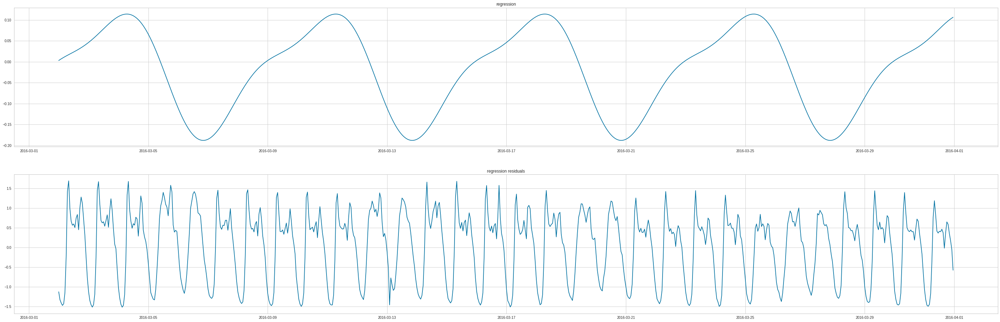

In [0]:
resids = reg_res_get_plot(ts_tr,reg_features=reg_feats(1,ts_tr.shape[0],kw=2,ky=0),regr=LinearRegression())

Критерий Дики-Фуллера: p=0.000017


/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)


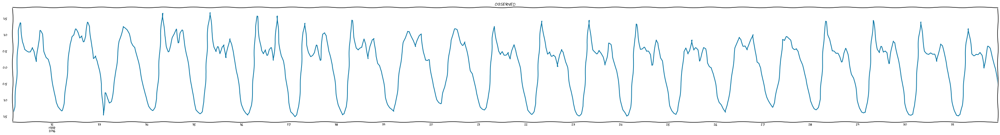

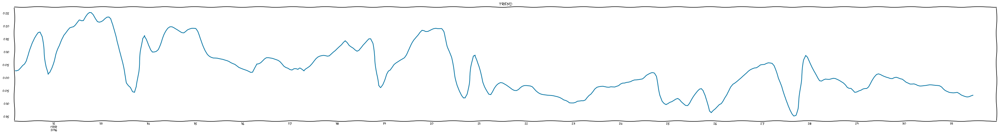

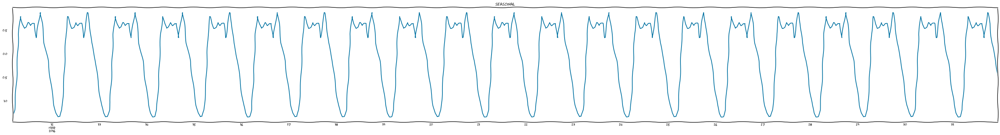

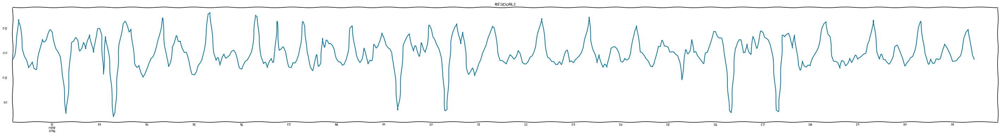

In [0]:
ts_df = resids.to_frame(name="resids")

stl_plot(ts_df.resids,lim=500)  
print("Критерий Дики-Фуллера: p=%f" % sm.tsa.stattools.adfuller(resids)[1])

Критерий Дики-Фуллера: p=0.000000


/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)


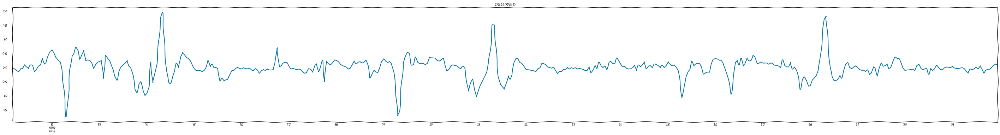

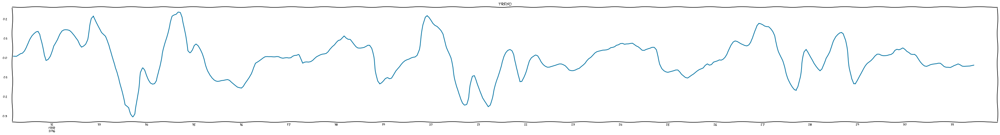

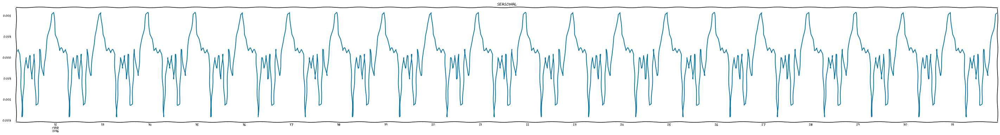

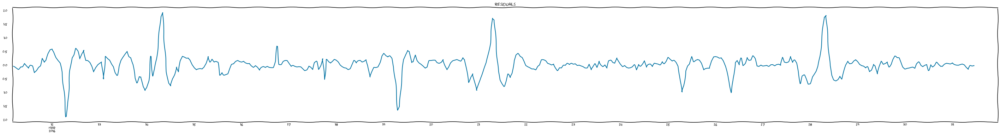

In [0]:
ts_df['diff1_resids'] = ts_df.resids - ts_df.resids.shift(24)

stl_plot(ts_df.diff1_resids[25:],lim=500)  
print("Критерий Дики-Фуллера: p=%f" % sm.tsa.stattools.adfuller(ts_df.diff1_resids[25:] )[1])

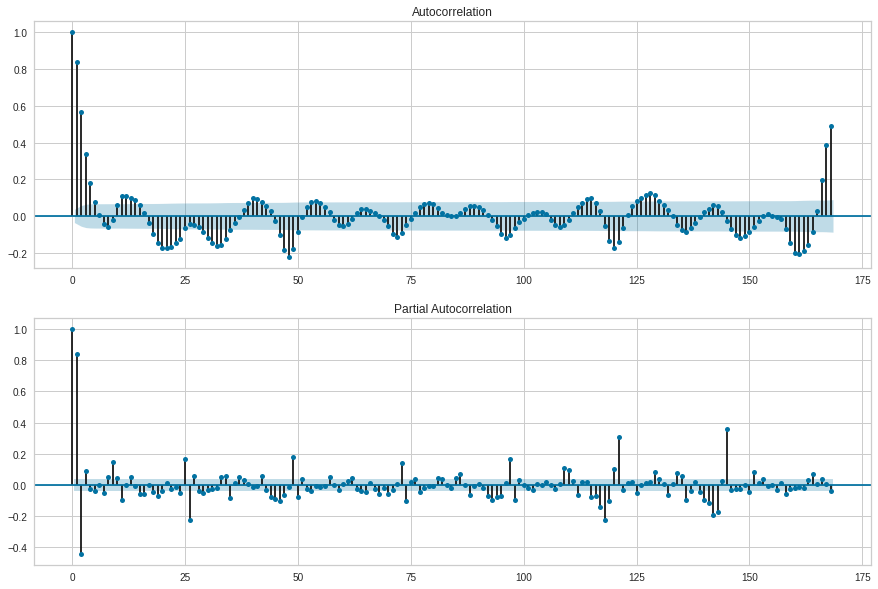

In [0]:
acf_pacf_plot(ts_df.diff1_resids[25:],n_lags=168)

In [0]:
ps = range(0, 3)
d=0
qs = range(0, 4)
Ps = range(0, 2)
D=1
Qs = range(0, 4)

In [0]:
parameters = product(ps, qs, Ps, Qs)
parameters_list = list(parameters)
len(parameters_list)

96

In [0]:
lim = 168
results = []
best_aic = float("inf")
warnings.filterwarnings('ignore')

for param in tqdm_notebook(parameters_list):
    #try except нужен, потому что на некоторых наборах параметров модель не обучается
    try:
        model = sm.tsa.statespace.SARIMAX(resids[-lim:], order=(param[0], d, param[1]), 
                                        seasonal_order=(param[2], D, param[3], 24)).fit(disp=-1)        
    #выводим параметры, на которых модель не обучается и переходим к следующему набору
    except ValueError:
        print('wrong parameters:', param)
        continue
    aic = model.aic
    #сохраняем лучшую модель, aic, параметры
    if aic < best_aic:
        best_model = model
        best_aic = aic
        best_param = param
    results.append([param, model.aic])
    
warnings.filterwarnings('default')


wrong parameters: (0, 0, 0, 2)
wrong parameters: (0, 0, 0, 3)
wrong parameters: (0, 0, 1, 2)
wrong parameters: (0, 0, 1, 3)
wrong parameters: (0, 1, 0, 2)
wrong parameters: (0, 1, 0, 3)
wrong parameters: (0, 1, 1, 2)
wrong parameters: (0, 1, 1, 3)
wrong parameters: (0, 2, 0, 2)
wrong parameters: (0, 2, 0, 3)
wrong parameters: (0, 2, 1, 2)
wrong parameters: (0, 2, 1, 3)
wrong parameters: (0, 3, 0, 2)
wrong parameters: (0, 3, 0, 3)
wrong parameters: (0, 3, 1, 2)
wrong parameters: (0, 3, 1, 3)
wrong parameters: (1, 0, 0, 2)
wrong parameters: (1, 0, 0, 3)
wrong parameters: (1, 0, 1, 2)
wrong parameters: (1, 0, 1, 3)
wrong parameters: (1, 1, 0, 2)
wrong parameters: (1, 1, 0, 3)
wrong parameters: (1, 1, 1, 2)
wrong parameters: (1, 1, 1, 3)
wrong parameters: (1, 2, 0, 2)
wrong parameters: (1, 2, 0, 3)
wrong parameters: (1, 2, 1, 2)
wrong parameters: (1, 2, 1, 3)
wrong parameters: (1, 3, 0, 2)
wrong parameters: (1, 3, 0, 3)
wrong parameters: (1, 3, 1, 2)
wrong parameters: (1, 3, 1, 3)
wrong pa

In [0]:
result_table = pd.DataFrame(results)
result_table.columns = ['parameters', 'aic']
print(result_table.sort_values(by = 'aic', ascending=True)[:10])

      parameters         aic
43  (2, 2, 1, 1) -115.058914
47  (2, 3, 1, 1) -114.371895
35  (2, 0, 1, 1) -110.028362
39  (2, 1, 1, 1) -109.383295
27  (1, 2, 1, 1) -108.369222
31  (1, 3, 1, 1) -106.757193
41  (2, 2, 0, 1) -106.629137
45  (2, 3, 0, 1) -106.193864
23  (1, 1, 1, 1) -104.141879
15  (0, 3, 1, 1) -103.556919


In [0]:
model = TimeSeriesModel(kw=2,ky=0,linear_fe=False,params=(best_param[0],d,best_param[1]),seasonal_params=(best_param[2],D,best_param[3],24),use_yj=False)

In [0]:
%%time
model.fit(pd.DataFrame(ts_tr[-720:]))
print(model.model.summary())

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  % freq, ValueWarning)
/usr/local/lib/python3.6/dist-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


                                 Statespace Model Results                                 
Dep. Variable:                                  3   No. Observations:                  720
Model:             SARIMAX(2, 0, 2)x(1, 1, 1, 24)   Log Likelihood                 227.720
Date:                            Mon, 25 May 2020   AIC                           -441.439
Time:                                    13:18:19   BIC                           -409.622
Sample:                                03-02-2016   HQIC                          -429.137
                                     - 03-31-2016                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.5074      0.049     30.520      0.000       1.411       1.604
ar.L2         -0.6702      0.031   

Критерий Стьюдента: p=0.003604
Критерий Дики-Фуллера: p=0.000000


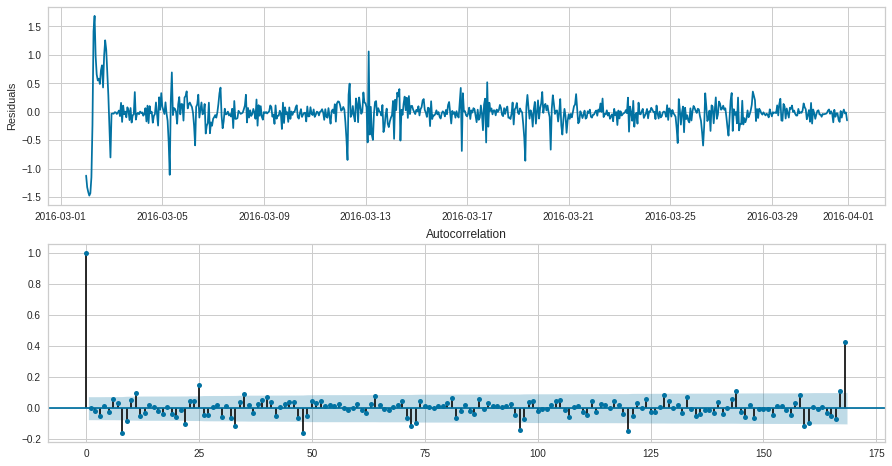

In [0]:
plt.figure(figsize=(15,8))
ax = plt.subplot(211)
ax.plot(model.model.resid[-720:])
plt.ylabel('Residuals')

ax = plt.subplot(212)
sm.graphics.tsa.plot_acf(model.model.resid[25:].squeeze(), lags=168, ax=ax)

print("Критерий Стьюдента: p=%f" % stats.ttest_1samp(model.model.resid[25:], 0)[1])
print("Критерий Дики-Фуллера: p=%f" % sm.tsa.stattools.adfuller(model.model.resid[25:])[1])

/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)


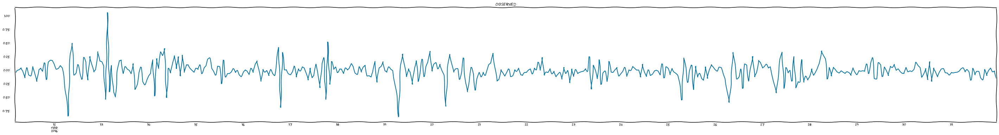

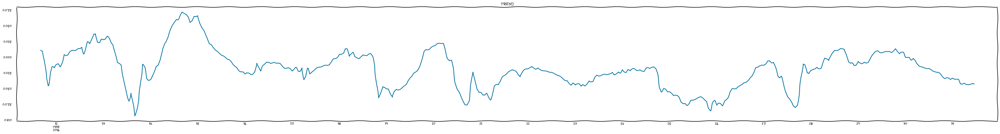

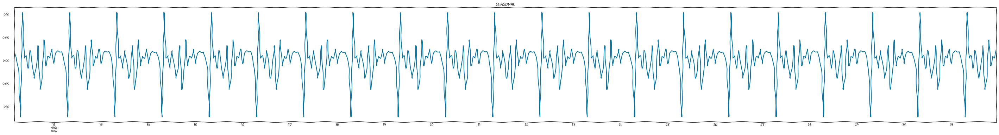

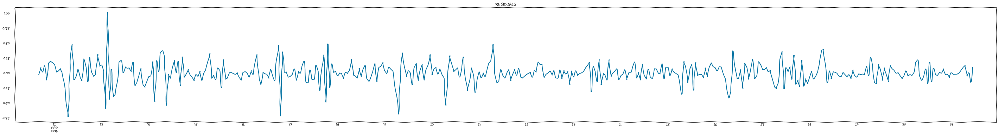

In [0]:
index=[pd.to_datetime(tt) for tt in ts_tr.index[-500:]]
ts_resids= pd.Series(model.model.resid[-500:],index=index)
stl_plot(ts_resids,lim=500)

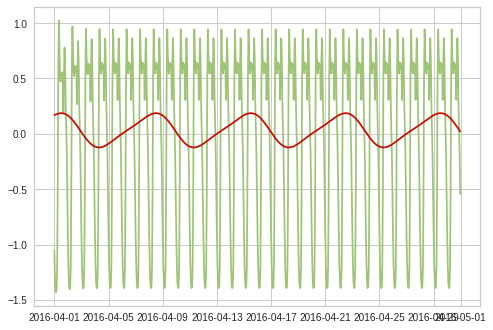

In [0]:
prediction = model.predict(pd.to_datetime('2016-04-01 00:00:00'),pd.to_datetime('2016-04-30 23:00:00'),verbose=True)

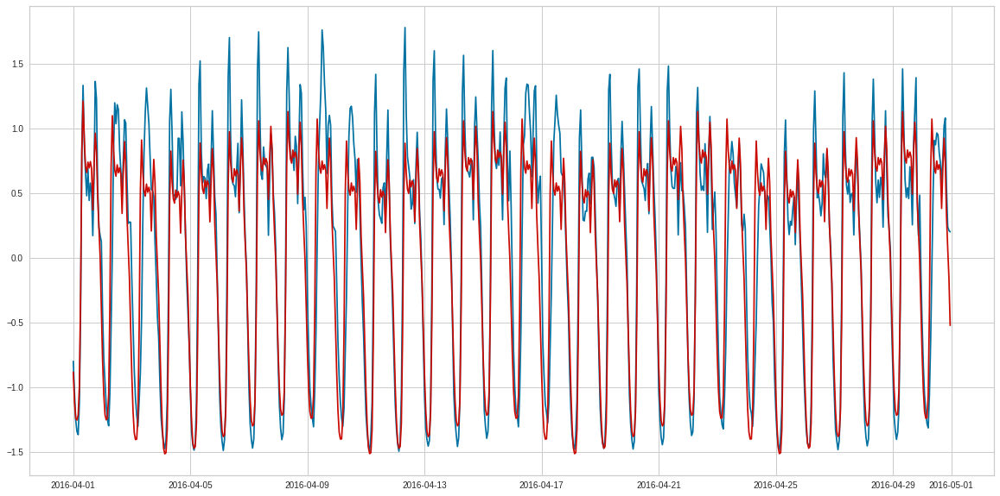

In [0]:
plt.figure(figsize=(20,10))
plt.plot(ts_val,color='b')
plt.plot(ts_val.index,prediction,color='r');


In [0]:
error = mae(ts_val,prediction)
error

0.24324247250799078

In [0]:
'''
cluster3_params:
kw=2
SARIMAX(2, 0, 2)x(1, 1, 1, 24)
use_yj=False
'''

'\ncluster3_params:\nkw=2\nSARIMAX(2, 0, 2)x(1, 1, 1, 24) \nuse_yj=False\n'

In [0]:
cl3_model_params= {'kw':2,
                  'params':(2, 0, 2),
                  'seasonal_params':(1, 1, 1, 24),
                  'use_yj':False
                  }

In [0]:
ts4 = time_series_centers[4]
ts = ts4.copy()
yj = PowerTransformer(method='yeo-johnson', standardize=False, copy=True)
yj.fit(ts.values.reshape(-1,1))
ts_work = pd.Series(yj.transform(ts.values.reshape(-1,1)).reshape(-1),index=ts.index)
ts_tr = ts_work.iloc[:-720]
ts_val = ts_work.iloc[-720:]
feats = reg_feats(1,ts_tr.shape[0],kw=3,ky=0)
feats.head()

,sin(2*pi*t*1/168),cos(2*pi*t*1/168),sin(2*pi*t*2/168),cos(2*pi*t*2/168),sin(2*pi*t*3/168),cos(2*pi*t*3/168)
0,0.037391,0.999301,0.074730,0.997204,0.111964,0.993712
1,0.074730,0.997204,0.149042,0.988831,0.222521,0.974928
2,0.111964,0.993712,0.222521,0.974928,0.330279,0.943883
3,0.149042,0.988831,0.294755,0.955573,0.433884,0.900969
4,0.185912,0.982566,0.365341,0.930874,0.532032,0.846724


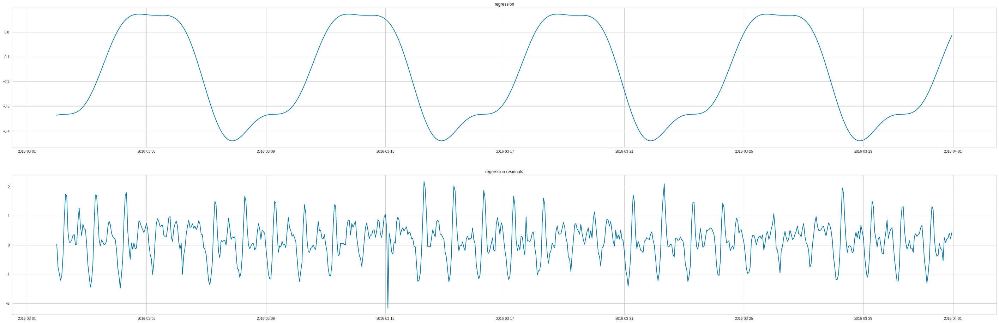

In [0]:
resids = reg_res_get_plot(ts_tr,reg_features=reg_feats(1,ts_tr.shape[0],kw=3,ky=0),regr=LinearRegression())

Критерий Дики-Фуллера: p=0.000000


/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)


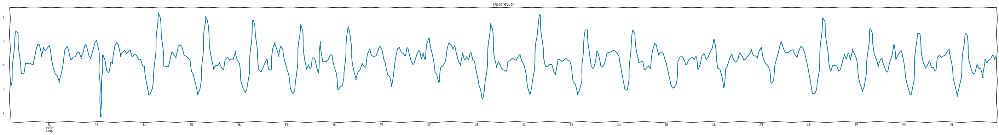

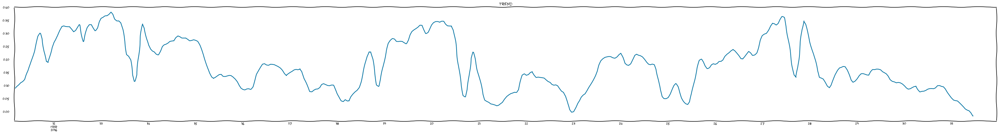

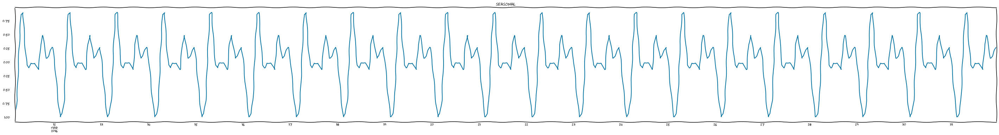

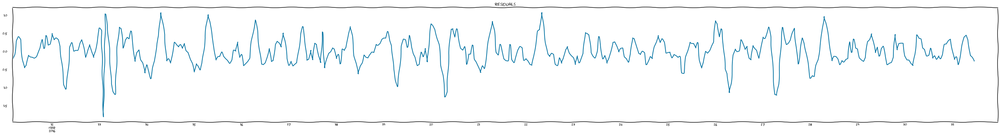

In [0]:
ts_df = resids.to_frame(name="resids")

stl_plot(ts_df.resids,lim=500)  
print("Критерий Дики-Фуллера: p=%f" % sm.tsa.stattools.adfuller(resids)[1])

Критерий Дики-Фуллера: p=0.000000


/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)


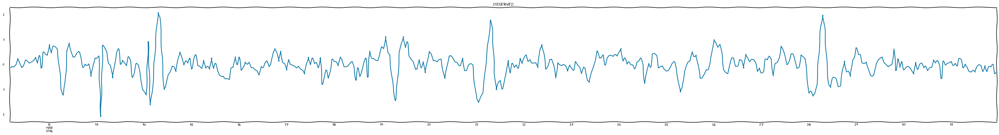

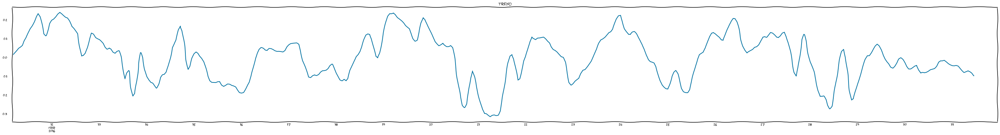

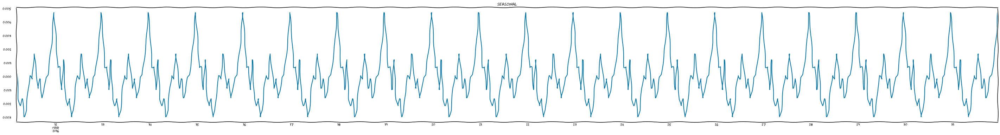

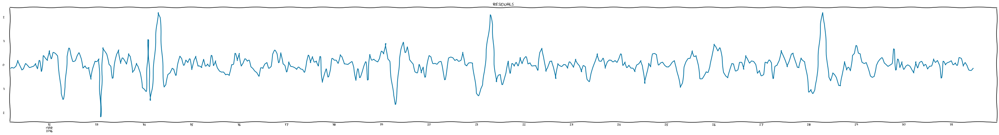

In [0]:
ts_df['diff1_resids'] = ts_df.resids - ts_df.resids.shift(24)

stl_plot(ts_df.diff1_resids[25:],lim=500)  
print("Критерий Дики-Фуллера: p=%f" % sm.tsa.stattools.adfuller(ts_df.diff1_resids[25:] )[1])

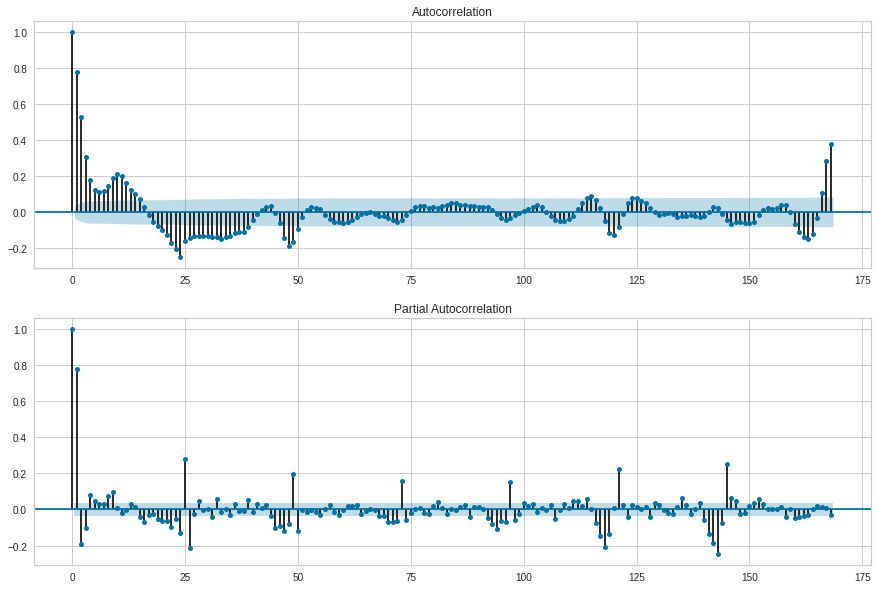

In [0]:
acf_pacf_plot(ts_df.diff1_resids[25:],n_lags=168)

In [0]:
ps = range(0, 3)
d=0
qs = range(0, 4)
Ps = range(0, 3)
D=1
Qs = range(0, 3)

In [0]:
parameters = product(ps, qs, Ps, Qs)
parameters_list = list(parameters)
len(parameters_list)

108

In [0]:
lim = 168
results = []
best_aic = float("inf")
warnings.filterwarnings('ignore')

for param in tqdm_notebook(parameters_list):
    #try except нужен, потому что на некоторых наборах параметров модель не обучается
    try:
        model = sm.tsa.statespace.SARIMAX(resids[-lim:], order=(param[0], d, param[1]), 
                                        seasonal_order=(param[2], D, param[3], 24)).fit(disp=-1)        
    #выводим параметры, на которых модель не обучается и переходим к следующему набору
    except ValueError:
        print('wrong parameters:', param)
        continue
    aic = model.aic
    #сохраняем лучшую модель, aic, параметры
    if aic < best_aic:
        best_model = model
        best_aic = aic
        best_param = param
    results.append([param, model.aic])
    
warnings.filterwarnings('default')

wrong parameters: (0, 0, 0, 2)
wrong parameters: (0, 0, 1, 2)
wrong parameters: (0, 0, 2, 2)
wrong parameters: (0, 1, 0, 2)
wrong parameters: (0, 1, 1, 2)
wrong parameters: (0, 1, 2, 2)
wrong parameters: (0, 2, 0, 2)
wrong parameters: (0, 2, 1, 2)
wrong parameters: (0, 2, 2, 2)
wrong parameters: (0, 3, 0, 2)
wrong parameters: (0, 3, 1, 2)
wrong parameters: (0, 3, 2, 2)
wrong parameters: (1, 0, 0, 2)
wrong parameters: (1, 0, 1, 2)
wrong parameters: (1, 0, 2, 2)
wrong parameters: (1, 1, 0, 2)
wrong parameters: (1, 1, 1, 2)
wrong parameters: (1, 1, 2, 2)
wrong parameters: (1, 2, 0, 2)
wrong parameters: (1, 2, 1, 2)
wrong parameters: (1, 2, 2, 2)
wrong parameters: (1, 3, 0, 2)
wrong parameters: (1, 3, 1, 2)
wrong parameters: (1, 3, 2, 2)
wrong parameters: (2, 0, 0, 2)
wrong parameters: (2, 0, 1, 2)
wrong parameters: (2, 0, 2, 2)
wrong parameters: (2, 1, 0, 2)
wrong parameters: (2, 1, 1, 2)
wrong parameters: (2, 1, 2, 2)
wrong parameters: (2, 2, 0, 2)
wrong parameters: (2, 2, 1, 2)
wrong pa

In [0]:
result_table = pd.DataFrame(results)
result_table.columns = ['parameters', 'aic']
print(result_table.sort_values(by = 'aic', ascending=True)[:10])

      parameters        aic
57  (2, 1, 1, 1)  38.760099
63  (2, 2, 1, 1)  39.177170
55  (2, 1, 0, 1)  39.460412
61  (2, 2, 0, 1)  39.785072
69  (2, 3, 1, 1)  39.910560
67  (2, 3, 0, 1)  40.600373
59  (2, 1, 2, 1)  40.647435
65  (2, 2, 2, 1)  41.142199
21  (0, 3, 1, 1)  41.304782
71  (2, 3, 2, 1)  41.875084


In [0]:
model = TimeSeriesModel(kw=3,ky=0,linear_fe=False,params=(best_param[0],d,best_param[1]),seasonal_params=(best_param[2],D,best_param[3],24),use_yj=True)

In [0]:
%%time
model.fit(pd.DataFrame(ts_tr[-720:]))
print(model.model.summary())

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  % freq, ValueWarning)


                                 Statespace Model Results                                 
Dep. Variable:                                  0   No. Observations:                  720
Model:             SARIMAX(2, 0, 1)x(1, 1, 1, 24)   Log Likelihood                 -91.439
Date:                            Mon, 25 May 2020   AIC                            194.878
Time:                                    13:34:34   BIC                            222.150
Sample:                                03-02-2016   HQIC                           205.423
                                     - 03-31-2016                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.4682      0.036     40.506      0.000       1.397       1.539
ar.L2         -0.6880      0.024   

Критерий Стьюдента: p=0.009157
Критерий Дики-Фуллера: p=0.000000


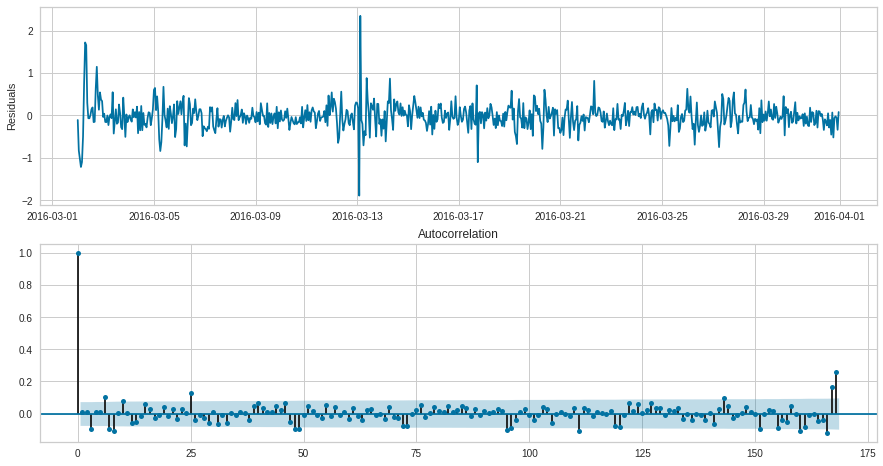

In [0]:
plt.figure(figsize=(15,8))
ax = plt.subplot(211)
ax.plot(model.model.resid[-720:])
plt.ylabel('Residuals')

ax = plt.subplot(212)
sm.graphics.tsa.plot_acf(model.model.resid[25:].squeeze(), lags=168, ax=ax)

print("Критерий Стьюдента: p=%f" % stats.ttest_1samp(model.model.resid[25:], 0)[1])
print("Критерий Дики-Фуллера: p=%f" % sm.tsa.stattools.adfuller(model.model.resid[25:])[1])

/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)


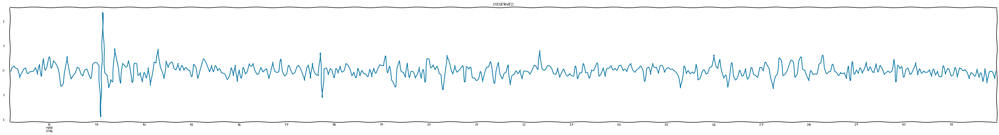

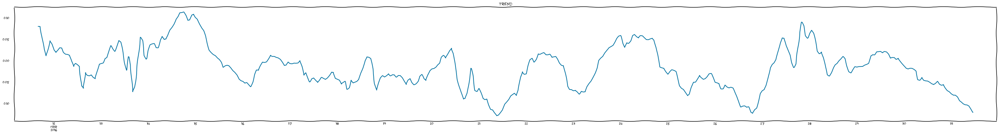

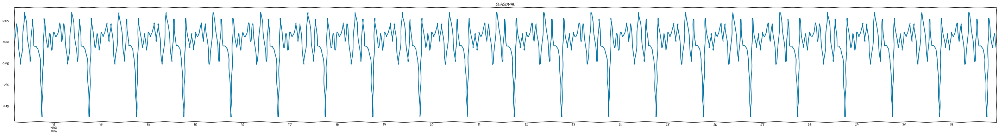

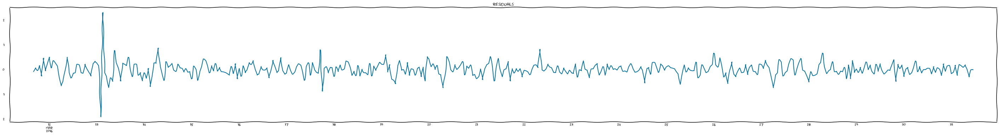

In [0]:
index=[pd.to_datetime(tt) for tt in ts_tr.index[-500:]]
ts_resids= pd.Series(model.model.resid[-500:],index=index)
stl_plot(ts_resids,lim=500)

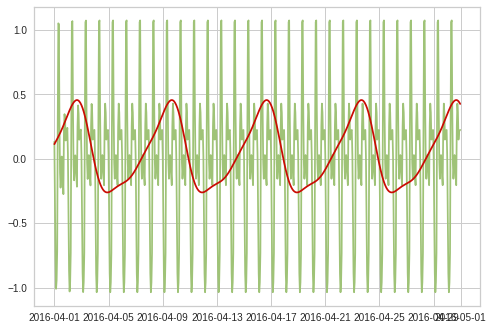

In [0]:
prediction = model.predict(pd.to_datetime('2016-04-01 00:00:00'),pd.to_datetime('2016-04-30 23:00:00'),verbose=True)

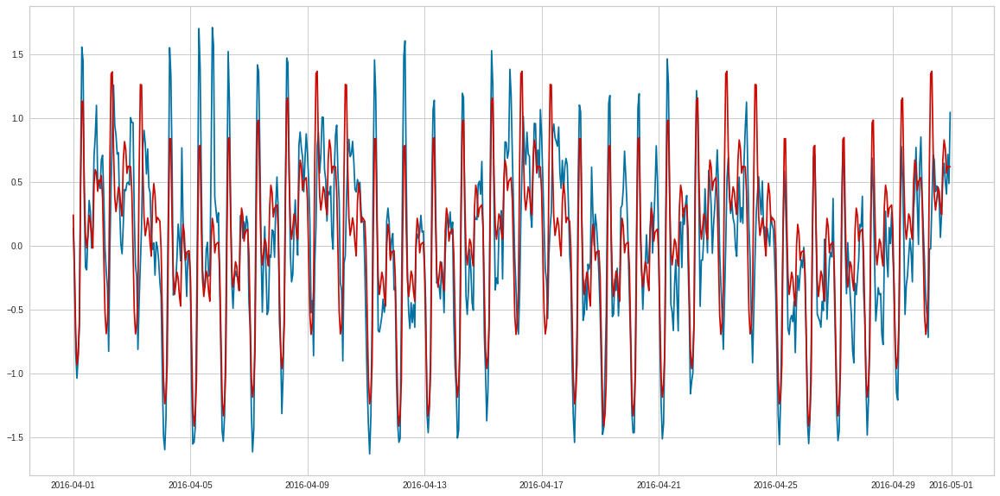

In [0]:
plt.figure(figsize=(20,10))
plt.plot(ts_val,color='b')
plt.plot(ts_val.index,prediction,color='r');


In [0]:
error = mae(ts_val,prediction)
error

0.29467693110592186

In [0]:
'''
cluster4_params:
kw=3
SARIMAX(2, 0, 1)x(1, 1, 1, 24) 
use_yj=True
'''

'\ncluster4_params:\nkw=3\nSARIMAX(2, 0, 1)x(1, 1, 1, 24) \nuse_yj=True\n'

In [0]:
cl4_model_params= {'kw':3,
                  'params':(2, 0, 1),
                  'seasonal_params':(1, 1, 1, 24),
                  'use_yj':True
                  }


Словарь с параметрами моделей для кластеров

In [37]:
cluster_params = [cl0_model_params,cl1_model_params,cl2_model_params,cl3_model_params,cl4_model_params]
cluster_params                 

[{'kw': 2,
  'params': (2, 0, 1),
  'seasonal_params': (1, 1, 1, 24),
  'use_yj': False},
 {'kw': 3,
  'params': (0, 0, 3),
  'seasonal_params': (0, 1, 1, 24),
  'use_yj': True},
 {'kw': 2,
  'params': (2, 0, 1),
  'seasonal_params': (1, 1, 1, 24),
  'use_yj': True},
 {'kw': 2,
  'params': (2, 0, 2),
  'seasonal_params': (1, 1, 1, 24),
  'use_yj': False},
 {'kw': 3,
  'params': (2, 0, 1),
  'seasonal_params': (1, 1, 1, 24),
  'use_yj': True}]

In [38]:
id_cluster_df

,0,1
0,1075,3
1,1076,3
2,1077,3
3,1125,0
4,1126,0
...,...,...
97,2068,0
98,2069,0
99,2118,0
100,2119,0


In [0]:
model_params_dict = {}
for zone_info in id_cluster_df.values:
  zone_id = zone_info[0]
  zone_cluster_id = zone_info[1]
  model_params = cluster_params[zone_cluster_id]  
  model_params_dict[zone_id] = model_params

Обучение моделей, сохранение параметров в файл. Обучаем на данных за декабрь.

In [0]:
path_to_params = os.path.join(PATH_TO_DATA,'models_params')

In [42]:
%%time
warnings.filterwarnings("ignore")
for zone in model_params_dict:
  ts = time_series_6_month[[zone]]
  model_params = model_params_dict[zone]
  model = TimeSeriesModel(kw=model_params['kw'],ky=0,linear_fe=False,params=model_params['params'],\
                                  seasonal_params=model_params['seasonal_params'],use_yj=model_params['use_yj'])
  model.fit(ts.iloc[:720],save_ar_params=True,PATH_TO_MODELS=path_to_params)  

CPU times: user 57min 47s, sys: 38min 53s, total: 1h 36min 40s
Wall time: 49min 6s


Расширяем модели на большие диапазоны, предсказаваем май и июнь.

In [44]:
%%time
warnings.filterwarnings("ignore")

predictions_may_dict = {}
predictions_june_dict = {}
for zone in model_params_dict:
  ts = time_series_6_month[[zone]]
  model_params = model_params_dict[zone]
  model = TimeSeriesModel(kw=model_params['kw'],ky=0,linear_fe=False,params=model_params['params'],\
                                  seasonal_params=model_params['seasonal_params'],use_yj=model_params['use_yj'])
  model.fit(ts.iloc[:720],load_ar_params=True,PATH_TO_MODELS=path_to_params)

  model.extend(ts.loc[:pd.to_datetime('2016-04-30 23:00:00')],refit_regressor=True) 
  prediction_may = model.predict(pd.to_datetime('2016-05-01 00:00:00'),pd.to_datetime('2016-05-31 23:00:00'))
  predictions_may_dict[zone] = prediction_may

  model.extend(ts,refit_regressor=True)
  prediction_june = model.predict(pd.to_datetime('2016-06-01 00:00:00'),pd.to_datetime('2016-06-30 23:00:00'))
  predictions_june_dict[zone] = prediction_june

CPU times: user 37min 41s, sys: 12min 7s, total: 49min 48s
Wall time: 26min 31s


Сохраняем предсказанные ряды.

In [58]:
for zone in predictions_june_dict:
  pred_june_df = pd.concat([predictions_june_dict[zone] for zone in predictions_june_dict],axis=1)

pred_june_df.columns = predictions_june_dict.keys()
pred_june_df.head()

,1075,1076,1077,1125,1126,1127,1128,1129,1130,1131,1132,1172,1173,1174,1175,1176,1177,1178,1179,1180,1181,1182,1183,1184,1221,1222,1223,1224,1225,1227,1228,1229,1230,1231,1232,1233,1234,1235,1272,1273,...,1376,1377,1378,1380,1382,1383,1384,1385,1386,1387,1388,1389,1390,1426,1431,1434,1435,1436,1437,1438,1439,1441,1442,1480,1482,1483,1530,1532,1533,1580,1630,1684,1733,1734,1783,2068,2069,2118,2119,2168
2016-06-01 00:00:00,25.602848,49.130421,22.834781,37.589112,86.189008,129.318363,236.866875,267.524731,401.724623,92.863217,-2.600604,6.027248,13.321816,13.859673,7.160289,20.129866,294.499688,322.571544,268.962279,193.404565,165.995748,249.497821,36.938725,2.654783,7.590464,10.694494,17.673687,21.616504,3.161814,180.369650,294.646716,189.767308,280.885958,431.594467,636.696620,236.764514,69.108532,30.603522,11.500498,14.165505,...,21.814167,12.249945,12.714513,8.368758,19.464541,40.767831,128.738847,63.918603,17.643904,18.779988,17.919012,10.895939,14.657657,10.299158,18.279455,0.565550,4.176442,17.505657,16.014293,6.375663,5.184466,4.693409,4.634301,8.772307,6.659493,4.950019,7.819770,10.063572,17.744083,3.225800,6.896608,5.778601,3.822963,203.870968,2.799939,83.793774,6.703642,192.363650,19.809387,106.060887
2016-06-01 01:00:00,11.528346,33.712753,7.908936,28.389927,46.468347,67.851360,169.538599,203.991694,335.769566,94.149448,-5.902810,3.361814,8.399324,10.802351,2.425238,18.334345,230.707263,253.413560,164.970711,91.474126,70.848982,189.527979,27.377814,2.301461,4.553841,6.832923,10.329821,16.577317,1.814006,151.285350,244.812138,120.806225,144.759521,319.566324,430.762515,132.238454,30.580548,9.742895,7.300693,9.553995,...,17.123085,11.285196,9.500690,6.809000,10.780288,24.439645,74.717998,40.849575,10.746959,14.280327,14.510208,7.326580,12.712123,8.403740,13.301065,0.495496,3.534233,15.126776,13.201751,5.115640,5.085488,3.381703,3.083040,8.365400,7.968915,4.655792,8.706467,11.406523,16.508975,2.806593,6.469764,4.108992,1.384134,52.489586,-36.660824,17.178802,4.416283,83.865299,7.683962,57.341299
2016-06-01 02:00:00,5.106288,23.936588,3.679640,19.375321,26.542561,47.515337,128.028321,167.148413,348.644233,92.828543,-4.844880,1.649249,7.549023,5.285678,1.110919,12.414553,172.171462,186.932878,113.838831,64.730853,90.194130,139.272847,26.015717,0.651096,2.710694,4.741723,6.143649,10.022187,1.289742,121.206034,206.576115,80.501396,89.432342,211.171810,321.329186,89.155574,4.488864,6.113053,3.411668,5.568412,...,15.604910,7.841521,6.212512,3.831416,9.132587,19.985705,49.281072,27.713248,10.088264,11.601841,8.957743,6.790691,8.428375,6.951316,11.287839,0.336661,2.185887,11.159926,10.273112,3.672835,3.469587,2.107846,2.603299,6.177351,6.801992,2.767174,7.620858,10.949528,14.191815,2.674581,6.734603,3.166284,0.347872,14.027742,-27.226730,1.158633,0.650942,8.658848,11.577983,11.662323
2016-06-01 03:00:00,3.770281,19.525668,4.005729,16.972328,19.946896,37.542932,78.172131,135.990752,295.628608,84.360872,-3.830816,0.776204,4.122795,3.209483,0.775795,8.430671,136.433946,138.812370,79.738994,37.992862,77.071347,127.206206,32.481212,0.949441,1.216534,2.683648,5.169032,6.632567,0.485467,85.706872,159.736007,63.457196,70.623162,178.128912,271.044948,72.011518,2.779411,3.977568,2.227269,2.370448,...,10.596939,5.205363,4.474024,2.094122,7.063544,25.589067,42.623634,30.396339,6.640531,6.240384,6.450700,3.624274,6.801639,4.305546,11.781310,0.392932,2.137163,7.053564,6.613474,3.680827,3.124686,1.707520,1.738111,3.921954,7.005958,3.502037,7.235800,8.302514,9.394762,2.044841,6.292126,2.637836,0.196365,8.851294,-19.104075,-4.550638,-0.291715,11.425633,0.740231,8.529192
2016-06-01 04:00:00,7.673063,19.316690,9.505673,19.729529,26.822484,29.834731,57.938463,97.810327,172.112999,48.259457,-3.882628,0.842680,6.329684,3.823319,1.291421,4.621724,83.687532,95.427462,91.925927,59.490891,144.090353,164.118238,31.823015,2.419160,1.688657,2.872059,5.732099,5.924174,0.323665,74.773981,135.739002,66.315475,91.117615,170.999309,280.596059,96.756725,17.310270,

In [59]:
for zone in predictions_may_dict:
  pred_may_df = pd.concat([predictions_may_dict[zone] for zone in predictions_may_dict],axis=1)

pred_may_df.columns = predictions_may_dict.keys()
pred_may_df.head()

,1075,1076,1077,1125,1126,1127,1128,1129,1130,1131,1132,1172,1173,1174,1175,1176,1177,1178,1179,1180,1181,1182,1183,1184,1221,1222,1223,1224,1225,1227,1228,1229,1230,1231,1232,1233,1234,1235,1272,1273,...,1376,1377,1378,1380,1382,1383,1384,1385,1386,1387,1388,1389,1390,1426,1431,1434,1435,1436,1437,1438,1439,1441,1442,1480,1482,1483,1530,1532,1533,1580,1630,1684,1733,1734,1783,2068,2069,2118,2119,2168
2016-05-01 00:00:00,62.889920,79.499906,35.576957,67.945393,219.485354,475.937411,639.288230,753.268031,873.979673,143.470673,11.800448,10.336260,45.300173,27.087775,7.379749,46.409655,860.170334,1016.551088,688.215344,842.66376,677.254889,759.582373,105.295644,8.799973,14.671939,28.468282,35.161970,41.830263,4.439611,580.293171,1121.218967,955.751913,1369.905672,715.954160,1124.548861,774.385127,417.167618,125.588532,22.900451,36.727308,...,66.825942,41.774879,24.497884,13.172885,7.511026,138.061953,439.503653,124.248329,22.786865,41.780196,39.688258,16.393127,15.044120,30.059965,26.969698,1.621956,7.919141,32.737323,27.400458,8.618687,6.560521,7.288578,5.871591,12.373658,27.839111,10.499069,11.402990,16.755071,22.823340,4.355113,7.257456,-11.337197,0.698530,33.207675,-77.135024,71.509333,13.643422,156.604317,15.584210,63.198536
2016-05-01 01:00:00,44.679738,49.992454,9.840262,42.995824,153.760125,404.292188,505.181362,634.184639,822.459390,150.284505,5.314556,5.855092,23.265742,16.455489,1.732265,41.283097,735.014984,871.446299,476.744596,679.98286,473.584094,546.839880,88.813760,4.408263,9.081551,19.997278,19.599874,27.043648,4.373338,521.167178,965.458149,818.467397,1070.782415,472.177405,785.037681,501.986108,234.250008,84.355778,14.336975,25.035372,...,53.997010,29.984509,17.341199,10.537786,2.219793,78.483650,323.541731,54.158047,15.288911,28.482348,26.773219,12.467124,14.913764,24.213989,20.691748,0.318194,7.035335,28.161956,20.554543,7.785029,7.309948,4.145921,3.880601,12.689868,25.488677,8.756506,9.710770,17.197880,20.810532,5.111820,9.811808,-8.128187,-1.388860,-92.462868,-115.311430,37.560627,7.276380,67.808814,18.269786,36.707738
2016-05-01 02:00:00,23.911220,34.867288,-2.555917,16.209278,94.089356,300.255709,367.561439,439.353931,728.788386,164.625506,1.981319,2.287556,14.958097,8.491731,2.434411,29.801700,552.030910,650.941778,312.477567,497.10632,317.938518,388.944688,66.598022,2.851675,4.839516,11.844579,12.670195,18.946923,2.403360,404.308211,721.511864,685.672017,827.009963,283.834861,542.803918,294.197623,135.895907,54.593531,8.477211,13.722814,...,44.177321,22.880131,14.980772,6.860456,-1.614885,26.493231,227.756125,33.854919,9.806094,19.458789,17.035787,8.936731,9.110665,17.287888,14.153623,-0.589165,5.290950,18.400980,15.298548,5.270125,4.155115,3.187618,2.576241,9.670769,14.782689,8.087280,10.474391,14.284219,17.996112,6.689699,10.215492,-8.346926,-1.366168,-90.368990,-103.401911,15.824301,1.561794,13.046093,5.936822,3.367847
2016-05-01 03:00:00,9.134244,22.984076,-13.118526,3.810697,58.115544,230.402477,218.022335,291.491344,633.290275,130.777331,3.350009,2.041656,8.533045,4.125103,1.506901,19.017757,381.740368,421.729300,218.124057,326.46825,166.987930,269.755937,65.327371,1.443845,2.343035,7.223137,7.683653,11.893628,1.233284,292.463428,497.480011,497.727800,549.706221,199.397407,390.770073,140.013452,83.084972,32.524705,4.313278,7.459006,...,29.307255,17.779298,8.552026,4.044462,-3.016978,2.852713,160.404688,7.563925,10.677547,13.143639,12.750490,8.274597,9.709358,10.318650,13.663314,-0.793196,4.510429,14.963014,11.632641,4.219684,3.764503,2.850179,2.210818,8.803369,12.656651,4.524631,11.831033,12.358094,15.253541,4.631604,10.232628,-7.467355,-1.294551,-80.122797,-92.873087,5.931089,1.796558,8.529268,5.390887,3.018664
2016-05-01 04:00:00,5.326245,5.317623,-14.887532,1.839695,49.075888,140.034637,123.068518,144.733572,344.250872,65.177509,2.718285,1.667752,9.366176,3.781785,1.395408,15.870300,194.294756,206.302376,141.237155,200.55175,111.077590,200.163533,52.808183,2.274450,1.889427,5.253806,9.681503,9

In [0]:
pred_june_df.to_csv('pred_june.csv')
pred_may_df.to_csv('pred_may.csv')

In [70]:
df_may = pd.read_csv('pred_may.csv',index_col = 0)
cols_may = [int(col) for col in df_may.columns]
df_may.columns = cols_may
dt_may = [pd.to_datetime(tt) for tt in list(df_may.index)]
df_may.index = dt_may
df_may.tail()

,1075,1076,1077,1125,1126,1127,1128,1129,1130,1131,1132,1172,1173,1174,1175,1176,1177,1178,1179,1180,1181,1182,1183,1184,1221,1222,1223,1224,1225,1227,1228,1229,1230,1231,1232,1233,1234,1235,1272,1273,...,1376,1377,1378,1380,1382,1383,1384,1385,1386,1387,1388,1389,1390,1426,1431,1434,1435,1436,1437,1438,1439,1441,1442,1480,1482,1483,1530,1532,1533,1580,1630,1684,1733,1734,1783,2068,2069,2118,2119,2168
2016-05-31 19:00:00,113.984351,211.356157,167.235028,123.672298,322.007444,423.903349,453.791205,412.749899,543.495946,232.129607,55.871867,4.461542,16.593823,27.209939,10.720860,18.490027,271.135112,628.944274,845.073377,959.359878,1061.457547,488.612630,127.491307,25.755258,2.806953,7.266005,12.046226,25.930189,4.541563,111.431673,308.193448,600.721037,1054.620178,1191.406046,1307.741924,889.038905,578.313407,225.659722,6.990739,6.789543,...,5.047201,3.584377,4.576635,6.950182,52.182466,351.445903,570.456921,316.687657,40.462130,26.921102,20.560985,11.527516,11.597930,1.815342,15.743963,15.793087,8.437470,28.424234,23.951683,8.718026,3.974044,3.364257,5.536913,5.724303,6.039410,5.571867,4.211822,1.767108,3.930293,1.462914,0.772279,22.692440,6.535750,302.996931,252.066145,124.079178,9.918435,190.913907,57.393150,111.042112
2016-05-31 20:00:00,104.668112,202.639888,148.982069,123.486612,313.548347,433.021787,479.999932,453.536225,566.359442,191.166452,37.972939,3.888451,14.383050,27.404804,10.157063,20.089348,315.064236,672.429924,810.964399,966.057265,987.362883,501.701334,94.440407,18.327333,3.004280,7.458412,15.079844,27.822928,4.700191,129.207407,366.050188,589.185561,1067.230166,1189.210182,1240.222685,813.917637,471.205541,169.433138,8.237528,8.979612,...,7.068331,6.105719,6.644366,7.053061,52.979058,269.876113,474.657215,256.844236,35.430386,28.073037,20.698227,12.196998,10.491663,2.397355,17.413189,8.456407,7.674398,26.756459,24.965736,8.473435,5.098284,3.631517,6.134986,5.071032,6.415242,5.181311,3.423192,2.836581,5.686564,1.181434,1.511602,22.795915,6.444654,308.480279,243.145190,134.055747,16.623853,223.735867,57.979906,120.900464
2016-05-31 21:00:00,107.140529,164.832592,139.333898,111.481478,297.033024,435.453307,522.011157,538.024953,587.462881,168.268427,36.400405,4.846857,17.168477,29.993831,11.245057,25.406298,362.865637,739.576630,780.539497,887.352259,939.829203,593.666859,87.343288,12.875654,5.716005,9.974737,20.239938,30.354975,4.240211,163.248719,445.314707,592.352980,1042.577562,1090.020735,1315.905762,899.259953,518.942529,150.198640,11.865324,13.179130,...,9.414645,7.354118,7.221681,8.351903,43.787574,222.938806,436.778497,209.136821,27.016562,27.803992,22.150288,13.976874,11.308176,3.262427,15.693765,6.248879,7.164085,26.136630,20.653113,8.026405,6.067550,4.395527,6.546223,4.572538,6.089547,5.974243,3.850912,2.890272,5.421398,0.851903,1.140072,14.830348,6.506245,311.413704,288.393767,126.195184,12.866787,163.701597,54.217831,112.938715
2016-05-31 22:00:00,89.989086,130.613788,119.898803,90.424240,242.414258,461.544761,555.398445,558.269870,579.987617,181.733108,27.707835,6.230490,22.585011,28.808306,10.548737,27.848412,406.554364,727.969126,734.782044,770.029847,920.010695,638.165685,100.726772,10.184144,6.500692,15.093726,32.180457,34.153041,4.990005,199.589763,533.628561,618.004533,1061.792988,1008.651111,1416.505579,1034.383566,556.805090,141.044825,13.986405,19.694852,...,15.198372,10.992444,10.459857,10.264707,36.741793,204.881512,385.303103,188.751681,32.954457,29.176131,21.199080,15.891000,14.439206,5.092312,16.585195,5.545951,6.050283,24.841922,23.999127,8.053604,5.548449,4.331760,7.370698,6.906751,9.106254,5.663139,4.784998,4.613889,6.762725,1.337032,2.129301,16.505113,5.910175,331.235351,250.498907,126.509095,15.958873,182.531475,32.452782,111.840714
2016-05-31 23:00:00,68.741049,108.526987,74.259116,78.854943,219.035485,420.593746,528.170928,520.854527,560.501248,138.413262,20.520166,7.157415,27.137537,29.777037,13.223572,27.606391,406.404931,693.201433,592.235935,693.089091,699.424611,544.212

In [71]:
df_june = pd.read_csv('pred_june.csv',index_col = 0)
cols_june = [int(col) for col in df_june.columns]
df_june.columns = cols_june
dt_june = [pd.to_datetime(tt) for tt in list(df_june.index)]
df_june.index = dt_june
df_june.tail()

,1075,1076,1077,1125,1126,1127,1128,1129,1130,1131,1132,1172,1173,1174,1175,1176,1177,1178,1179,1180,1181,1182,1183,1184,1221,1222,1223,1224,1225,1227,1228,1229,1230,1231,1232,1233,1234,1235,1272,1273,...,1376,1377,1378,1380,1382,1383,1384,1385,1386,1387,1388,1389,1390,1426,1431,1434,1435,1436,1437,1438,1439,1441,1442,1480,1482,1483,1530,1532,1533,1580,1630,1684,1733,1734,1783,2068,2069,2118,2119,2168
2016-06-30 19:00:00,109.463852,201.695093,159.927854,113.000785,305.204383,408.089729,449.772034,424.379972,569.692332,240.813359,47.011677,4.613599,17.040332,29.666985,12.610905,20.721046,331.864038,639.018347,742.959372,877.342652,1044.462869,493.829584,139.070137,24.075821,2.610151,8.314129,13.954154,27.665482,6.060243,137.428456,332.976754,638.974304,984.830547,1044.324809,1236.158902,853.965651,517.789439,228.938590,7.948357,7.976769,...,5.692447,3.827101,5.748426,8.060033,52.350777,320.350740,602.583479,287.732917,41.026489,29.172157,21.155672,14.204128,13.382847,2.258370,13.548652,13.274714,10.118643,33.751612,29.026332,8.952641,4.911512,3.547319,6.253477,6.093920,6.415774,6.034069,4.296835,2.371086,5.427810,1.252524,1.321715,23.156578,7.814198,321.910763,293.185480,127.213521,16.096515,207.194705,52.129362,117.553181
2016-06-30 20:00:00,100.480215,181.838195,146.623751,104.482304,310.226941,390.985717,451.277609,458.488011,599.070065,219.821382,31.089641,4.161461,17.636312,26.676042,14.152531,24.512783,383.831049,674.029971,699.284113,837.468099,967.191792,506.847505,109.310886,19.487705,4.126397,8.712949,14.716773,30.433393,6.292213,159.873248,390.699823,629.548042,984.442458,978.263810,1164.863590,785.551436,415.846475,170.399246,9.543578,10.603442,...,7.023407,6.437734,5.551690,8.351790,50.997193,240.313015,504.229425,219.226341,37.863905,29.758320,21.809038,15.376065,14.390834,2.951549,14.339826,6.483289,9.292201,33.129697,30.217367,9.703956,5.737103,4.437704,6.620505,5.982013,7.319268,6.303635,5.573618,3.566118,4.590072,2.584670,1.309966,23.900664,7.439413,324.586358,293.142394,156.248409,21.733152,268.130644,81.942265,134.352453
2016-06-30 21:00:00,104.479046,182.251810,110.350563,100.947193,274.998819,396.656453,496.711892,540.561439,637.076257,219.068291,26.167774,5.321157,20.979953,32.210843,15.063605,28.144938,443.428202,724.619200,675.051613,772.160640,930.444835,589.097487,102.545943,13.966265,4.382283,11.775177,17.747098,34.000045,7.577870,204.023972,474.737488,634.601786,967.425460,984.961267,1246.074053,845.508534,463.611943,157.994710,12.997372,12.357642,...,11.961622,9.419517,9.402110,10.024378,37.761625,197.040196,467.428980,201.359335,30.594684,31.538824,24.554295,16.500992,16.806080,4.109559,16.047877,5.650307,9.148002,33.568591,28.746550,8.874674,7.035914,4.302503,7.144853,6.349873,7.320277,7.915828,5.845980,4.314249,7.023139,2.032405,1.534682,20.045878,6.550058,323.963174,308.114901,150.039457,16.799883,190.803973,64.424868,149.984286
2016-06-30 22:00:00,89.917768,128.142460,98.764431,101.143332,223.721793,408.550836,502.204453,555.088950,619.865528,212.621987,18.864039,7.224015,28.636077,36.495365,16.250087,31.039017,499.637899,705.791886,621.459129,674.300845,912.605913,628.500073,115.577498,11.899126,8.028365,17.938519,26.393674,34.203993,8.199208,250.785234,559.069600,661.084391,947.494096,871.318288,1308.799474,873.742769,406.307600,139.186563,16.125919,19.230304,...,18.749365,13.757112,12.253557,12.173886,33.266106,171.414008,415.737457,162.630530,31.182080,32.109430,25.111915,17.606959,18.065899,6.490571,21.495414,3.688007,7.898861,33.862151,30.388887,9.389813,7.515619,5.763094,8.545929,6.491652,11.020124,8.651573,7.070606,5.678346,10.791229,2.158264,2.187200,20.399687,6.989715,362.792455,299.967942,133.008649,18.769318,202.541770,54.484838,148.529189
2016-06-30 23:00:00,68.380899,97.475651,67.579392,80.701830,183.727459,354.669582,471.594286,527.738628,623.671230,176.323621,10.179119,9.320742,31.408247,33.142992,20.299948,29.074108,505.161671,669.696536,518.261200,606.709099,687.070953,563.73

Ниде приведен набросок онлайн алгоритма, который можно было бы использовать для предсказания на 6 часов вперед. Расширяем модель до временной точки, затем предсказываем на 6 часов, записываем ответ в результат.

In [0]:
'''
%%time
time_points = list(ts.loc[pd.to_datetime('2016-04-30 23:00:00'):pd.to_datetime('2016-05-31 17:00:00')].index)
result_df = pd.DataFrame(columns=['y'])
for zone in model_dict:
  ts = time_series_6_month[[zone]]
  for time in time_points:
    model_dict[zone].extend(ts.loc[:time],refit_regressor=True)  
    start = time + relativedelta(hours=1)
    stop = time + relativedelta(hours=6)  
    prediction = model_dict[zone].predict(start,stop)
    time_string = '_'.join([str(zone),str(time.date()),str(time.hour)])  
    for ind,value in enumerate(prediction.values):
      val_id = '_'.join([time_string,str(ind+1)])
      result_df.loc[val_id] = value
      
result_df 
''' 

В нашем случае, в связи с ограничениями во времени и ресурсах, воспользуемся менее точным, но гораздо более быстрым алгоритмом. Воспользуемся предсказанными уже данными в предыдущих пунктах и распределим их по временным точкам. 

In [0]:
def create_result(df,time_points):

  time_inds = []
  for zone in zones:
    for time_point in time_points:
      for count in range(1,7):
        time_string = '_'.join([str(zone),str(time_point.date()),str(time_point.hour),str(count)])
        time_inds.append(time_string)

  parts_list = []
  for time in time_points:   
     part = df.loc[time+relativedelta(hours=1):time+relativedelta(hours=6)].copy()  
     parts_list.append(part)
  values = pd.concat(parts_list).values.T.reshape(-1,1)

  result = pd.DataFrame(values,index = time_inds,columns=['y'])
  return result  
  

Результат для мая

In [109]:
result_may = create_result(df_may,time_points)
result_may.tail()

,y
2168_2016-05-31_17_2,111.042112
2168_2016-05-31_17_3,120.900464
2168_2016-05-31_17_4,112.938715
2168_2016-05-31_17_5,111.840714
2168_2016-05-31_17_6,69.599901


истинные данные за май

In [111]:
real_may = create_result(time_series_6_month[zones],time_points)
real_may.head()

,y
1075_2016-04-30_23_1,71
1075_2016-04-30_23_2,37
1075_2016-04-30_23_3,10
1075_2016-04-30_23_4,14
1075_2016-04-30_23_5,6


Ошибка предсказания мая

In [112]:
error_pred = mae(real_may,result_may)
error_pred

33.33505722018154

Получим предсказания для июня, проверим на Kaggle

In [0]:
time_points_june = list(pd.date_range(start=pd.to_datetime('2016-05-31 23:00:00'),end=pd.to_datetime('2016-06-30 17:00:00'),freq='1H'))
answer_df = create_result(df_june,time_points_june)

In [0]:
answer_df.to_csv('submission.csv',index_label='id')

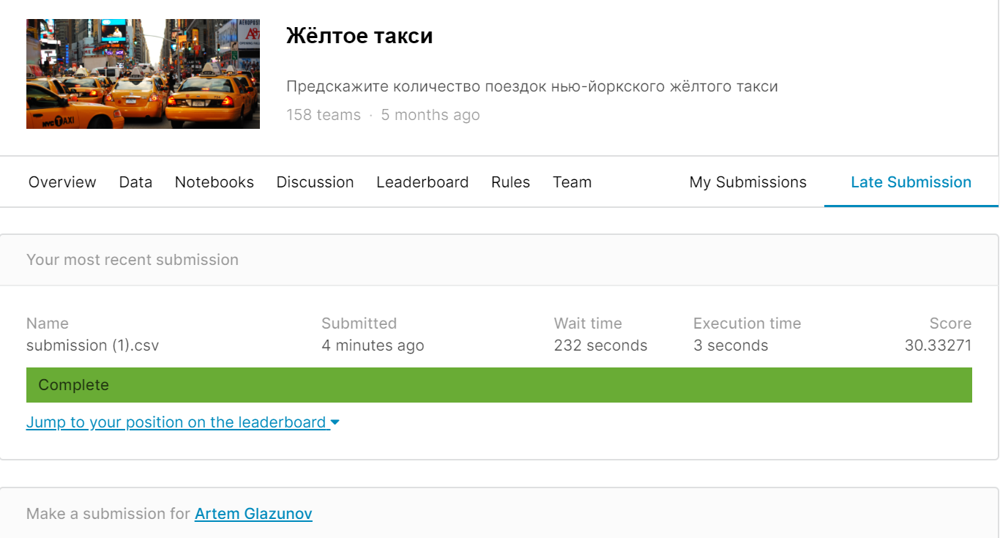

Итак, для модели, которая работала всего 1,5 часа на среднем железе такой результат, на мой взгляд, довольно неплох.
Для улучшения результата можно подбирать модели не для 5 кластеров, а для 10, при этом вместо того, чтобы обучать на 1 месяце и расширять на больший диапазон, можно обучать сразу на всех данных.